This analysis is based on the videos generated in the following folder: /Volumes/L_MillerLab/data/Pop_18E3/Videos/20220203/data-UChicago/Modified_Videos/jarvis_testing_modified_compressed_30crf_presetfaster

- Step 1: Run modified videos through jarvis and obtain position data
- Step 2: Interpolate position data where dropped/duplicated frames occur
- Step 3: Get joint angles based on interpolated data
- Step 4a: Do PCA on joint angles; plot PCA over time
- Step 4b: Get joint speeds based based on joint angles (will mostly be noise, consider filtering? Butterworth filter)
- Step 5: Correlate angle data to 

In [1]:
# This is used to import matlab_jarvis_files, which exists in the above directory
import sys
sys.path.append('../')

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matlab_jarvis_files import get_jarvis_errors
from matlab_jarvis_files import scatter_jarvis_errors
import scipy
from scipy import stats
from scipy import signal
from matlab_jarvis_files import plot_linklengths as pl
import joint_angles as ja
from sklearn.decomposition import PCA

# ONLY RUN ONCE - Get Jarvis Predictions from Modified Frame-Inserted Videos

In [39]:
parent_path = '/Volumes/L_MillerLab/limblab/User_folders/Aajan/Jarvis_results/Aajan-MonkeyHand-PretrainedWeights-20220512/Pop/0712_Predictions_3D_20220712-133726/'
data_file_name = 'data3D.csv'
data_path = parent_path+data_file_name

In [43]:
data = np.genfromtxt(data_path, delimiter=',')
data.shape

(37456, 69)

# ONLY RUN ONCE - Linear Interpolation for Position Data

In [5]:
#subtract 1 from all indeces because matlab starts at 1, python starts at 0
cam_dupe_indeces_0 = np.genfromtxt('/Volumes/L_MillerLab/data/Pop_18E3/Videos/20210712/Data/Duplicated_Frames/cam_0_duplicate_frames.txt')
cam_dupe_indeces_0 = (cam_dupe_indeces_0-1).astype(int)
cam_dupe_indeces_1 = np.genfromtxt('/Volumes/L_MillerLab/data/Pop_18E3/Videos/20210712/Data/Duplicated_Frames/cam_1_duplicate_frames.txt')
cam_dupe_indeces_1 = (cam_dupe_indeces_1-1).astype(int)
cam_dupe_indeces_2 = np.genfromtxt('/Volumes/L_MillerLab/data/Pop_18E3/Videos/20210712/Data/Duplicated_Frames/cam_2_duplicate_frames.txt')
cam_dupe_indeces_2 = (cam_dupe_indeces_2-1).astype(int)
cam_dupe_indeces_3 = np.genfromtxt('/Volumes/L_MillerLab/data/Pop_18E3/Videos/20210712/Data/Duplicated_Frames/cam_3_duplicate_frames.txt')
cam_dupe_indeces_3 = (cam_dupe_indeces_3-1).astype(int)

logfile_0 = np.genfromtxt('/Volumes/L_MillerLab/data/Pop_18E3/Videos/20210712/Data/Old_Logfiles/cam_0_logfile.txt')
logfile_1 = np.genfromtxt('/Volumes/L_MillerLab/data/Pop_18E3/Videos/20210712/Data/Old_Logfiles/cam_1_logfile.txt')
logfile_2 = np.genfromtxt('/Volumes/L_MillerLab/data/Pop_18E3/Videos/20210712/Data/Old_Logfiles/cam_2_logfile.txt')
logfile_3 = np.genfromtxt('/Volumes/L_MillerLab/data/Pop_18E3/Videos/20210712/Data/Old_Logfiles/cam_3_logfile.txt')

In [6]:
cam_dupe_indeces_0.shape, cam_dupe_indeces_1.shape, cam_dupe_indeces_2.shape, cam_dupe_indeces_3.shape

((1448,), (1453,), (1449,), (1451,))

### Create Dictionary with number of cameras dropped per frame

In [35]:
cam_dupe_indeces = [cam_dupe_indeces_0,cam_dupe_indeces_1,cam_dupe_indeces_2,cam_dupe_indeces_3]

d = {}

for cam_dupes in cam_dupe_indeces:
    for ind in cam_dupes:
        if ind not in d:
            d[ind] = 1
        else:
            d[ind]+=1
d = dict(sorted(d.items()))

In [36]:
len(d)

1900

### Note: if two numbers occur in a row here, it's because not all cameras dropped the same number of frames (e.g. cameras 0,1,2 drop one frame, then camera 3 drops one frame immediately after)

In [37]:
d

{0: 4,
 175: 4,
 177: 4,
 179: 3,
 180: 1,
 350: 4,
 352: 4,
 354: 4,
 356: 4,
 452: 4,
 512: 1,
 513: 3,
 521: 2,
 522: 2,
 539: 4,
 605: 4,
 649: 4,
 656: 1,
 657: 3,
 701: 2,
 702: 2,
 758: 2,
 759: 2,
 1064: 2,
 1065: 2,
 1070: 4,
 1072: 4,
 1142: 1,
 1143: 3,
 1427: 4,
 1429: 4,
 1431: 4,
 1541: 4,
 1573: 4,
 1666: 3,
 1667: 1,
 1711: 1,
 1712: 3,
 1760: 4,
 1781: 4,
 1783: 4,
 1785: 4,
 1787: 4,
 1953: 4,
 2063: 4,
 2065: 4,
 2090: 2,
 2091: 2,
 2273: 1,
 2274: 3,
 2276: 4,
 2285: 1,
 2286: 3,
 2416: 4,
 2477: 4,
 2479: 4,
 2747: 4,
 2999: 4,
 3057: 4,
 3124: 3,
 3125: 1,
 3131: 4,
 3257: 1,
 3258: 3,
 3260: 1,
 3261: 3,
 3302: 4,
 3304: 4,
 3306: 4,
 3317: 4,
 3356: 2,
 3357: 2,
 3383: 4,
 3407: 4,
 3409: 4,
 3434: 4,
 3436: 4,
 3438: 4,
 3445: 4,
 3482: 4,
 3497: 4,
 3797: 4,
 3799: 4,
 3824: 4,
 3950: 3,
 3951: 1,
 3957: 4,
 4103: 4,
 4105: 4,
 4130: 4,
 4166: 4,
 4321: 4,
 4465: 4,
 4579: 3,
 4580: 1,
 4642: 3,
 4643: 1,
 4673: 4,
 4727: 2,
 4728: 2,
 4867: 4,
 4869: 4,
 4874

### Get number of frames dropped per camera (based on old logfiles)

In [107]:
a = np.array([[1, 1], [2, 2], [3, 3]])
np.insert(a, 1, 5, axis=0)

array([[1, 1],
       [5, 5],
       [2, 2],
       [3, 3]])

In [102]:
logfile_list = [logfile_0, logfile_1, logfile_2, logfile_3]
diff_matx = []
for logfile in logfile_list:
    diff_list = []
    for x, y in zip(logfile[0:], logfile[1:]):
        diff_list.append(y-x)
    diff_list.append(0.033)
    diff_matx.append(diff_list)

diff_matx = np.array(diff_matx)

num_frames_dropped = (np.round(diff_matx/0.033)-1).T

In [172]:
col_list = []
for i in range(4):
    col = num_frames_dropped[:,i]
    j = 0
    while j < len(col):
        if j%1000==0:
            print(j)
        elem = int(col[j])
        # array, place, value, axis
        k = 0
        while k < elem:
            col = np.insert(col, j+k+1, 0)
            j+=1
            k+=1
        j+=1
    col = col[:36000]
    col_list.append(col)

0
1000
2000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
15000
16000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000
31000
32000
33000
34000
35000
36000
37000
0
1000
2000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
15000
17000
18000
19000
20000
21000
22000
23000
24000
25000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000
0
1000
2000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
15000
16000
17000
18000
19000
20000
21000
22000
23000
24000
25000
26000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000
0
1000
2000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
15000
17000
18000
19000
20000
21000
22000
23000
24000
25000
27000
28000
29000
30000
31000
32000
33000
34000
35000
36000
37000


In [173]:
doubles = np.vstack(col_list).T

In [174]:
doubles.shape

(36000, 4)

In [175]:
doubles

array([[1., 1., 1., 1.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],


In [105]:
len(num_frames_dropped)

36000

In [106]:
np.unique(np.where(num_frames_dropped > 1)[0])

array([ 7119,  7123, 14851, 22882, 25234, 26123, 27775, 30637, 35638])

In [176]:
np.unique(np.where(doubles > 1)[0])

array([ 7233,  7240, 15230, 23624, 26140, 27097, 28853, 31874])

### Linear Interpolation. Do not interpolate where adjacent frames have drops. Do not interpolate if more than one frame dropped in a row. In case of no interpolation, insert nans

In [177]:
nan_ind_list = []
non_nan_ind_list = []

#INTERPOLATE IF NO ADJACENT FRAMES DROPPED
#NAN OTHERWISE
for ind in d:
    if (((ind+1) in d) or ((ind-1) in d)):
        data[ind][:] = np.nan
        nan_ind_list.append(ind)
    else:
        data[ind] = (data[ind-1]+data[ind+1])/2
        non_nan_ind_list.append(ind)

#NAN IF MULTIPLE DROPPED FRAMES IN A ROW
mult_frames_inds = np.unique(np.where(doubles > 1)[0])
for ind in mult_frames_inds:
    data[ind][:] = np.nan
    nan_ind_list.append(ind)

In [178]:
len(non_nan_ind_list)

1001

In [179]:
# NUMBER OF INSERTED NANS IN DATASTREAM
len(nan_ind_list)

907

In [54]:
data_interpolated_file_name = 'data3D_linear_interpolation.csv'
data_interpolated_path = parent_path+data_interpolated_file_name

In [55]:
data_cutoff = data[:36000,:]

In [56]:
data_cutoff.shape

(36000, 69)

In [57]:
import csv
with open(data_interpolated_path, "w") as f:
    writer = csv.writer(f)
    writer.writerows(data_cutoff)

In [78]:
import csv
with open('/Users/aajanquail/Downloads/data3D_linear_interpolation.csv', "w") as f:
    writer = csv.writer(f)
    writer.writerows(data_cutoff)

# Use Linearly Interpolated Data to Generate Joint Angles

In [93]:
# angles = ja.get_joint_angles(data_interpolated_path)
angles = ja.get_joint_angles('/Users/aajanquail/Downloads/data3D_linear_interpolation.csv')

Shape: num time points, num fingers, num joints

angles[0,0,:] gets all the joints for a single finger (in this case pinky) at one time point (in this case frame 0)

angles[0,:,0] gets a single joint type (in this case DIP) for all fingers at one time point (in this case frame 0)

In [94]:
angles.shape

(36000, 5, 3)

# Check for NaN points in Jarvis Predictions

In [95]:
l_not_nan = []
l_nan = []
print('The following frames have nans for all keypoints:')
for i in range(len(angles)):
    if (~np.isnan(angles)[i]).all():
        l_not_nan.append(i)
    if (np.isnan(angles)[i]).all():
        print(i)
        l_nan.append(i)

The following frames have nans for all keypoints:
179
180
238
245
247
249
250
251
253
254
255
256
512
513
521
522
656
657
701
702
758
759
1064
1065
1142
1143
1666
1667
1711
1712
2090
2091
2273
2274
2285
2286
3124
3125
3257
3258
3260
3261
3356
3357
3950
3951
4579
4580
4642
4643
4727
4728
4909
4910
5002
5003
5113
5114
5650
5651
6151
6152
6288
6289
6454
6455
7119
7123
7559
7560
7705
7706
8203
8204
8256
8257
8349
8350
8485
8486
8782
8783
8927
8928
9027
9028
9308
9309
9835
9836
9840
9841
9982
9983
10027
10028
10491
10492
10629
10630
10639
10640
10849
10850
11090
11091
11509
11510
11517
11518
11601
11602
11683
11684
11914
11915
11958
11959
11971
11972
12208
12209
12220
12221
12223
12224
12265
12266
12408
12409
12499
12500
12508
12509
12583
12584
12616
12617
12745
12746
12754
12755
12786
12787
12802
12803
12874
12875
12882
12883
12982
12983
13160
13161
13191
13192
13208
13209
13210
13211
13233
13234
13309
13310
13312
13313
13403
13404
13471
13472
13804
13805
13843
13844
13858
13859
13927
1392

In [96]:
len(l_nan), len(l_not_nan), 

(861, 35139)

In [97]:
# ONLY RUN IF YOU WANT TO GET RID OF NANS!
angles_nans_removed = angles[l_not_nan,:,:]
angles_nans_removed.shape

(35139, 5, 3)

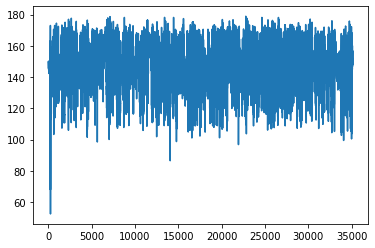

In [90]:
plt.plot(angles[:,4,2])

In [98]:
angles_reshaped = np.reshape(angles, (-1,15))
angles_nans_removed_reshaped = np.reshape(angles_nans_removed, (-1,15))

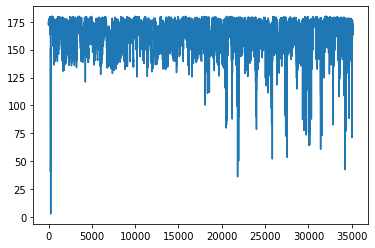

In [89]:
plt.plot(angles_reshaped[:,0])

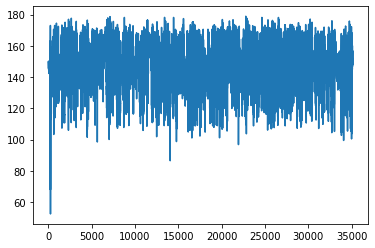

In [91]:
plt.plot(angles_reshaped[:,14])

In [99]:
angles_reshaped.shape, angles_nans_removed_reshaped.shape

((36000, 15), (35139, 15))

In [79]:
data_cutoff.shape

(36000, 69)

In [100]:
with open('/Users/aajanquail/Downloads/joint_angles_nans_kept.csv', "w") as f:
    writer = csv.writer(f)
    writer.writerows(angles_reshaped)

In [101]:
with open('/Users/aajanquail/Downloads/joint_angles_nans_removed.csv', "w") as f:
    writer = csv.writer(f)
    writer.writerows(angles_nans_removed_reshaped)

# PCA Analysis - Plot vs Neural Data

A note on how the filters were chosen: I used 4 poles and a 0.3 corner (which corresponds to a frequency of 4.5Hz, since the sampling rate is 30Hz, thus the Nyquist frequency is 30/2 = 15Hz, and 15x0.3 = 4.5Hz). These values were chosen based on plots in the "filtering" section at the bottom of the notebook. 4 poles 4.5Hz seemed to properly capture the behavior of the data while removing unwanted noise.

Steps:
1) Extract 10 "good" segments from neural and joint angle data. Segments provided by Eric.

2) Concatenate segments into single vector.

3) Obtain PC1 from concatenated vectors.

4) Calculate angular velocity PC1 for each joint.

5) Filter PC1 using Butterworth filter - 4 poles, 4.5 Hz corner.

5) Save filtered PC1 for Hinge Joints and neural data in .mat file.

## Import Neural Data

In [67]:
from scipy import io as scio
neural_data = scio.loadmat('/Users/aajanquail/Downloads/20210712_units_smoothed.mat')

In [5]:
type(neural_data), neural_data

(dict,
 {'__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: Mon Jul 11 16:00:37 2022',
  '__version__': '1.0',
  '__globals__': [],
  'units_smoothed': array([[0.        , 0.        , 0.        , ..., 0.54978999, 0.35897023,
          0.21358843],
         [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
          0.        ],
         [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
          0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.8646735 , 0.81469972,
          0.768396  ],
         [0.        , 0.        , 0.        , ..., 0.67757761, 0.75972253,
          0.84630969],
         [0.        , 0.        , 0.03049436, ..., 0.40466046, 0.37672737,
          0.35475645]])})

In [69]:
neural_data['units_smoothed'].shape

(142, 36001)

In [183]:
l_not_nan

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 181,
 182,
 183,
 184,
 185,
 186,


In [181]:
len(l_not_nan)

35139

In [75]:
neural_data['units_smoothed'][:,:36000][:,l_not_nan].shape

(142, 35139)

In [185]:
with open('/Users/aajanquail/Downloads/l_not_nan.csv', 'w') as f:
      
    # using csv.writer method from CSV package
    write = csv.writer(f)
    for num in l_not_nan:
        write.writerow([num])

In [77]:
neural_data_nans_removed = neural_data['units_smoothed'][:,:36000][:,l_not_nan]
scio.savemat('/Users/aajanquail/Downloads/20210712_units_smoothed_nans_removed.mat', {'neural_data_nans_removed': neural_data_nans_removed})

### Extract relevant time segments and concatenate them

In [ ]:
array([ 7119,  7123, 14851, 22882, 25234, 26123, 27775, 30637, 35638])

In [7]:
ranges = [(690,990),(2130,2430),(4770,5070),(10890,11190),(12510,12810),(13080,13380),(16140,16440),(22050,22350),(26580,26880),(29160,29460)]

In [8]:
ranges_seconds = [(i[0]/30,i[1]/30) for i in ranges]
ranges_seconds

[(23.0, 33.0),
 (71.0, 81.0),
 (159.0, 169.0),
 (363.0, 373.0),
 (417.0, 427.0),
 (436.0, 446.0),
 (538.0, 548.0),
 (735.0, 745.0),
 (886.0, 896.0),
 (972.0, 982.0)]

In [9]:
neural_data_segments = neural_data['units_smoothed'][:,np.r_[690:990,2130:2430,4770:5070,10890:11190,12510:12810,13080:13380,16140:16440,22050:22350,26580:26880,29160:29460]].T
mcp_joints_segments = angles[np.r_[690:990,2130:2430,4770:5070,10890:11190,12510:12810,13080:13380,16140:16440,22050:22350,26580:26880,29160:29460],:4,2]
pip_joints_segments = angles[np.r_[690:990,2130:2430,4770:5070,10890:11190,12510:12810,13080:13380,16140:16440,22050:22350,26580:26880,29160:29460],:4,1]
dip_joints_segments = angles[np.r_[690:990,2130:2430,4770:5070,10890:11190,12510:12810,13080:13380,16140:16440,22050:22350,26580:26880,29160:29460],:4,0]
hinge_joints_segments = angles[np.r_[690:990,2130:2430,4770:5070,10890:11190,12510:12810,13080:13380,16140:16440,22050:22350,26580:26880,29160:29460],:4,:2].reshape(3000,8)

In [10]:
neural_data_segments.shape, mcp_joints_segments.shape, pip_joints_segments.shape, dip_joints_segments.shape, hinge_joints_segments.shape

((3000, 142), (3000, 4), (3000, 4), (3000, 4), (3000, 8))

In [11]:
pca_neural = PCA(n_components=1)
neural_pc1 = pca_neural.fit_transform(neural_data_segments).flatten()
pca_mcp = PCA(n_components=1)
mcp_angle_pc1 = pca_mcp.fit_transform(mcp_joints_segments).flatten()
pca_pip = PCA(n_components=1)
pip_angle_pc1 = pca_pip.fit_transform(pip_joints_segments).flatten()
pca_dip = PCA(n_components=1)
dip_angle_pc1 = pca_dip.fit_transform(dip_joints_segments).flatten()
pca_hinge = PCA(n_components=1)
hinge_angle_pc1 = pca_hinge.fit_transform(hinge_joints_segments).flatten()

In [12]:
hinge_angle_pc1.shape

(3000,)

In [13]:
x_axis_time = np.arange(3000)/30

In [14]:
mcp_velocity_pc1 = np.diff(mcp_angle_pc1)/np.diff(x_axis_time)
pip_velocity_pc1 = np.diff(pip_angle_pc1)/np.diff(x_axis_time)
dip_velocity_pc1 = np.diff(dip_angle_pc1)/np.diff(x_axis_time)
hinge_velocity_pc1 = np.diff(hinge_angle_pc1)/np.diff(x_axis_time)

In [15]:
# get rid of values at edge of time segments
velocities = [mcp_velocity_pc1, pip_velocity_pc1, dip_velocity_pc1, hinge_velocity_pc1]
new_velocities = []
for v in velocities:
    v = np.append(v, 0)
    v = v.reshape(10,300)
    v = v[:,:-1]
    v = v.reshape(-1)
    new_velocities.append(v)

In [16]:
mcp_velocity_pc1 = new_velocities[0]
pip_velocity_pc1 = new_velocities[1]
dip_velocity_pc1 = new_velocities[2]
hinge_velocity_pc1 = new_velocities[3]

In [19]:
order = 4
corner = 0.3
b, a = scipy.signal.butter(order, corner)

filtered_mcp_angle_pc1 = scipy.signal.filtfilt(b, a, mcp_angle_pc1)
filtered_pip_angle_pc1 = scipy.signal.filtfilt(b, a, pip_angle_pc1)
filtered_dip_angle_pc1 = scipy.signal.filtfilt(b, a, dip_angle_pc1)
filtered_hinge_angle_pc1 = scipy.signal.filtfilt(b, a, hinge_angle_pc1)

filtered_mcp_velocity_pc1 = scipy.signal.filtfilt(b, a, mcp_velocity_pc1)
filtered_pip_velocity_pc1 = scipy.signal.filtfilt(b, a, pip_velocity_pc1)
filtered_dip_velocity_pc1 = scipy.signal.filtfilt(b, a, dip_velocity_pc1)
filtered_hinge_velocity_pc1 = scipy.signal.filtfilt(b, a, hinge_velocity_pc1)

## PCA Analysis - MCP Joints

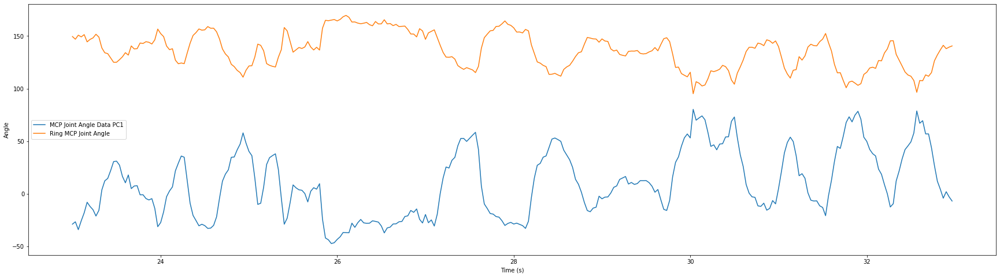

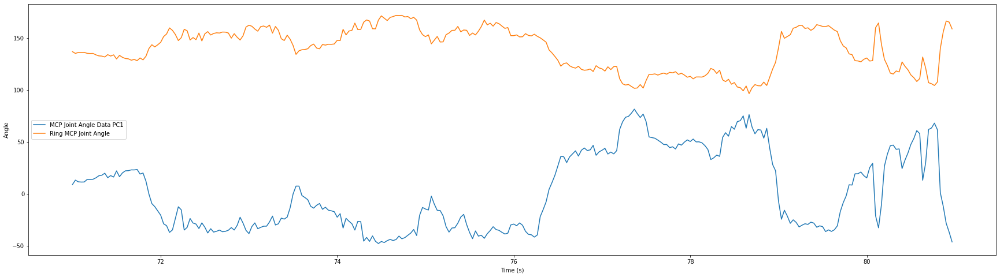

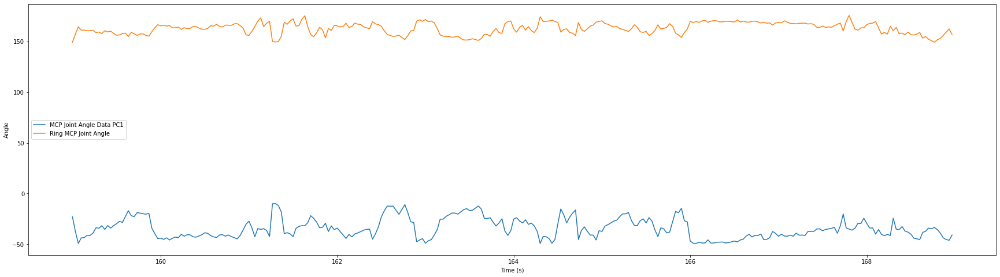

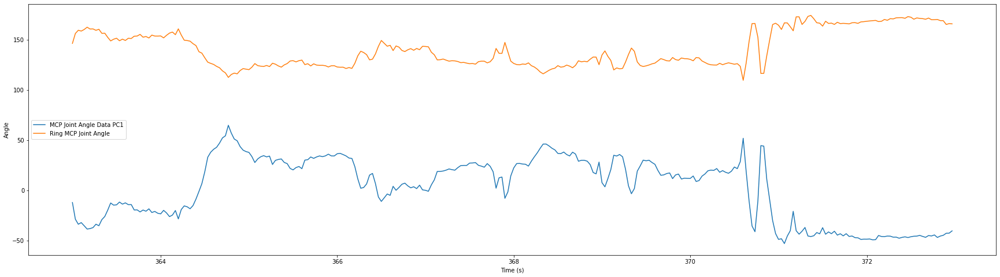

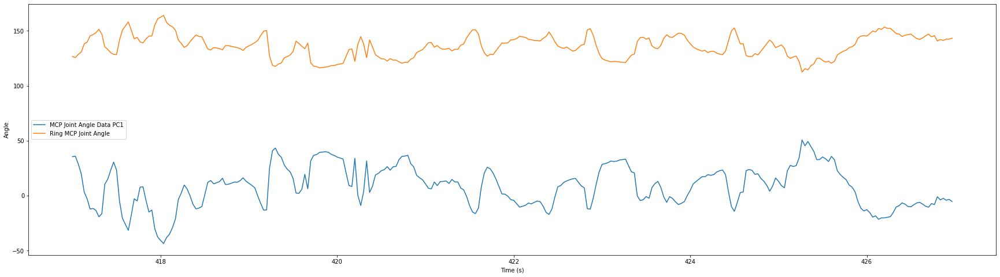

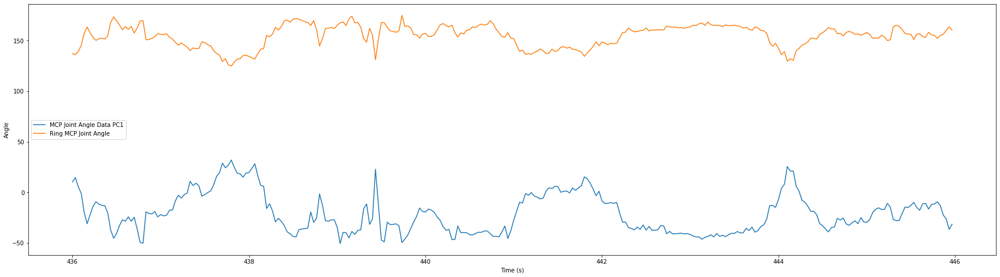

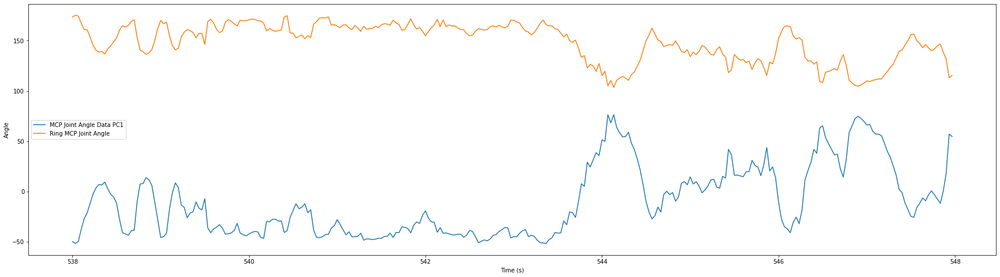

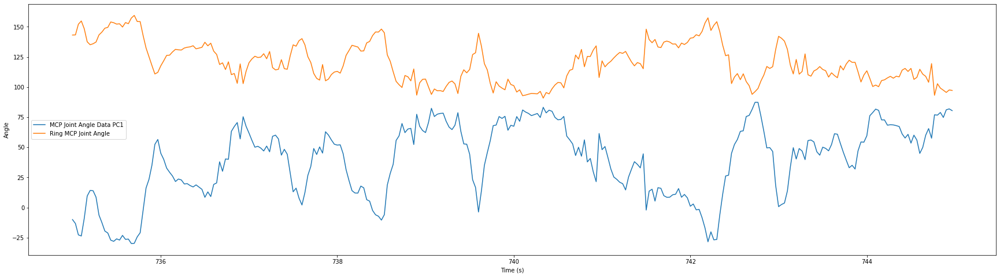

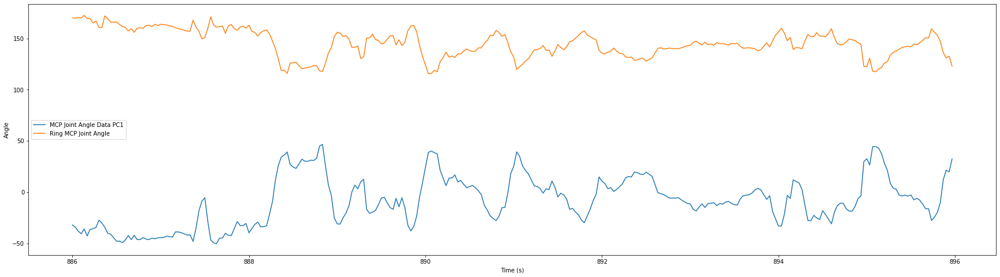

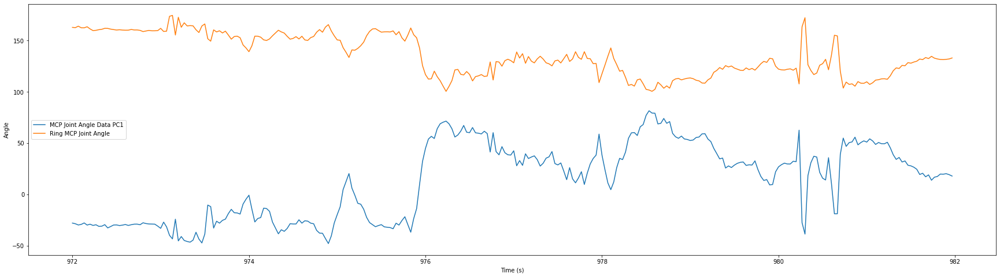

In [17]:
for i in range(len(ranges)):    
    plt.figure(figsize=(30,8))
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    plt.plot(xaxis_seconds, mcp_angle_pc1[i*300:(i+1)*300])
    plt.plot(xaxis_seconds, mcp_joints_segments[i*300:(i+1)*300,1])
    plt.xlabel('Time (s)')
    plt.ylabel('Angle')
    plt.legend(['MCP Joint Angle Data PC1','Ring MCP Joint Angle'], loc = 'center left')
    plt.show()

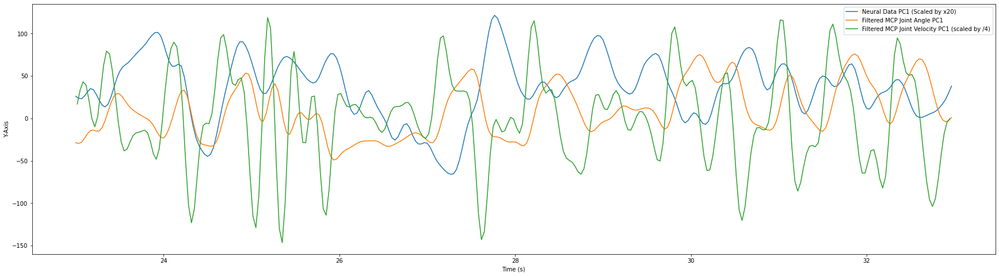

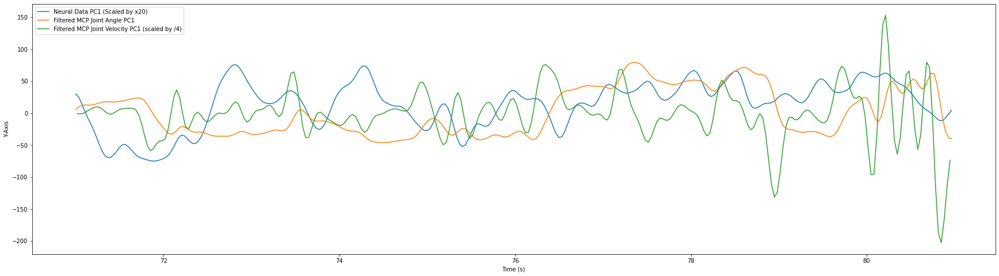

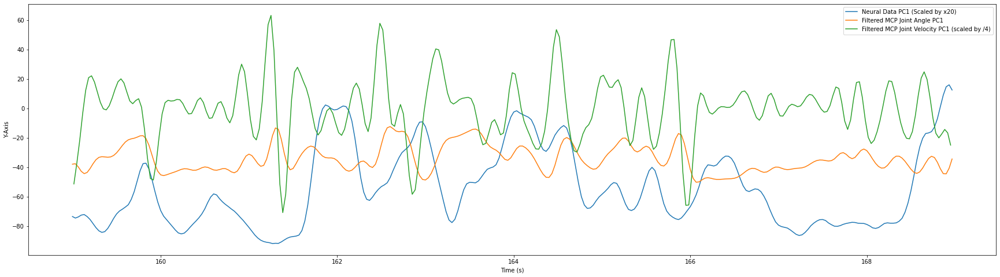

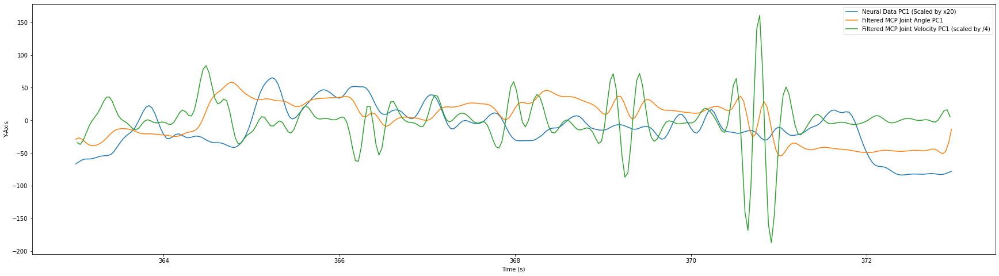

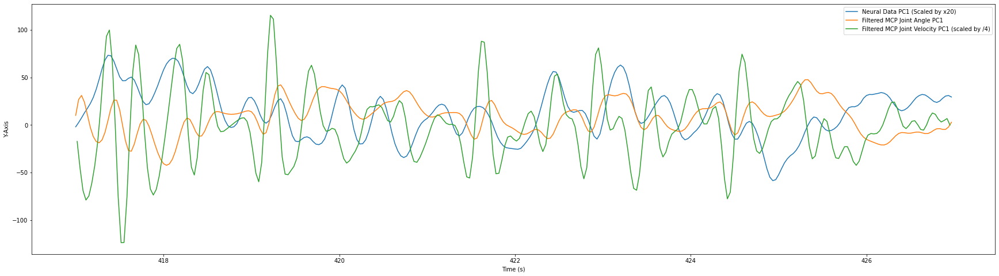

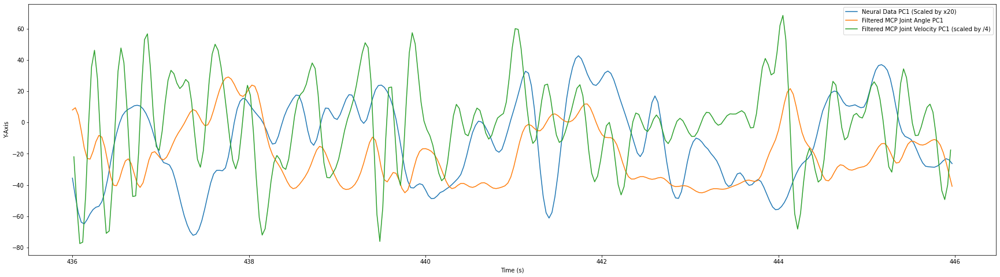

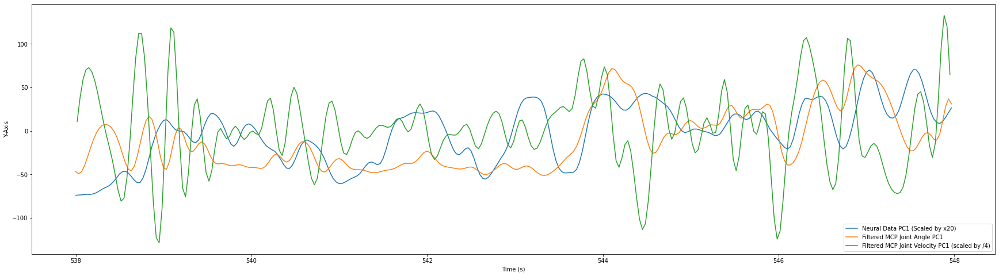

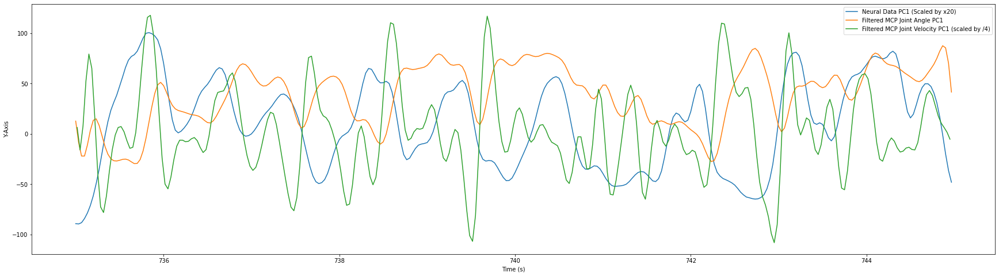

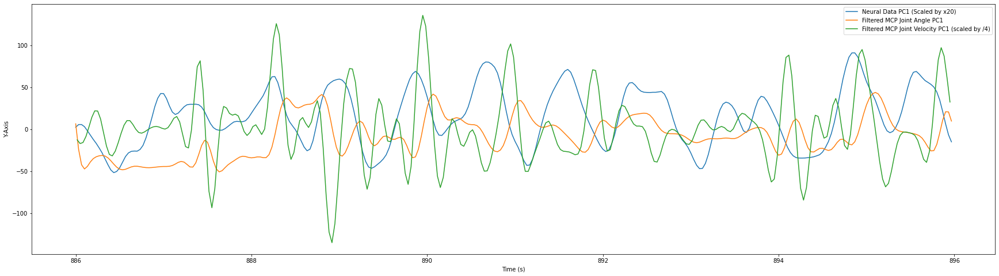

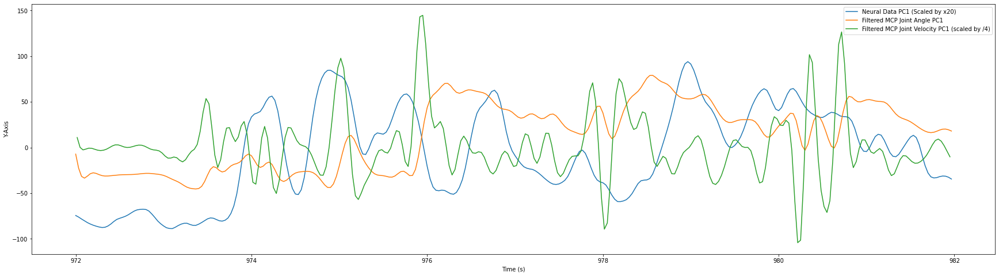

In [22]:
  for i in range(len(ranges)):
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    x2 = (xaxis_seconds[:-1] + xaxis_seconds[1:]) / 2

    plt.figure(figsize=(30,8))
    plt.plot(xaxis_seconds, neural_pc1[i*300:(i+1)*300]*20)
    plt.plot(xaxis_seconds, filtered_mcp_angle_pc1[i*300:(i+1)*300])
    plt.plot(x2, filtered_mcp_velocity_pc1[i*299:(i+1)*299]/4)
    plt.xlabel('Time (s)')
    plt.ylabel('Y-Axis')
    plt.legend(['Neural Data PC1 (Scaled by x20)', 'Filtered MCP Joint Angle PC1', 'Filtered MCP Joint Velocity PC1 (scaled by /4)'])
    plt.show()

## PCA Analysis - PIP Joints

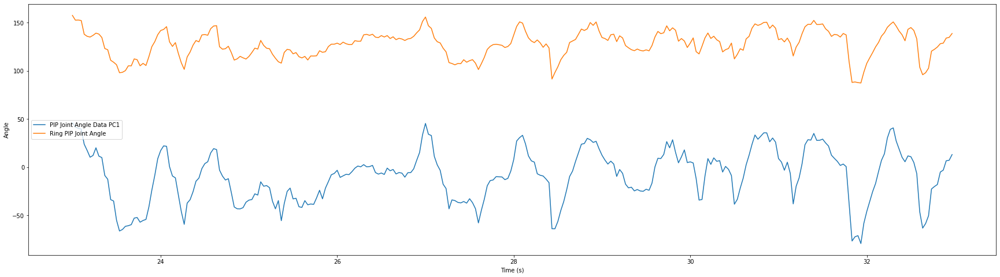

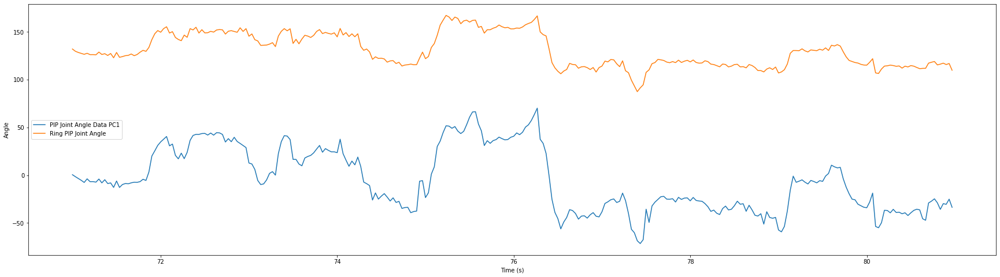

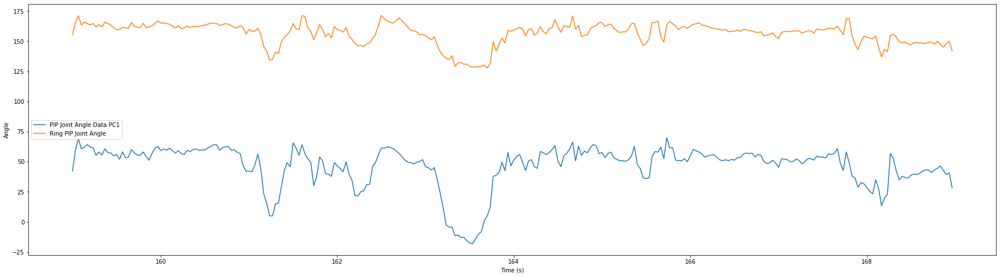

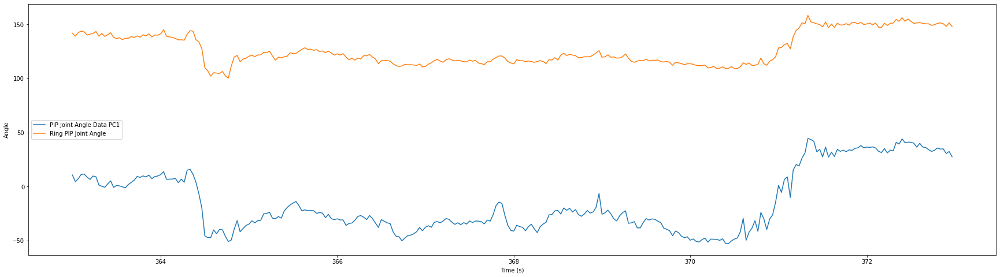

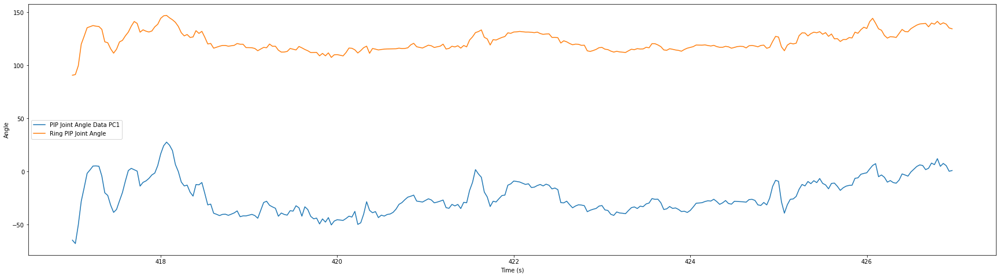

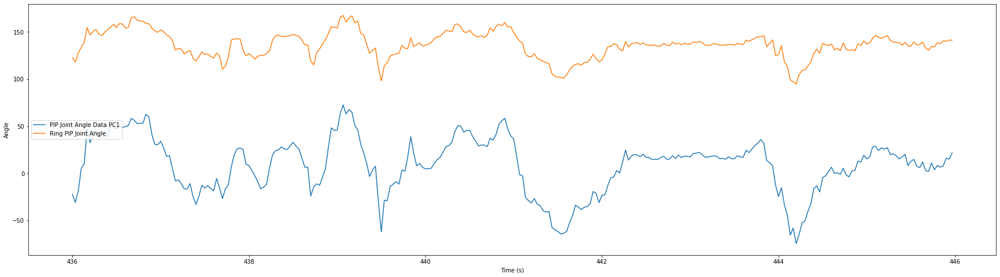

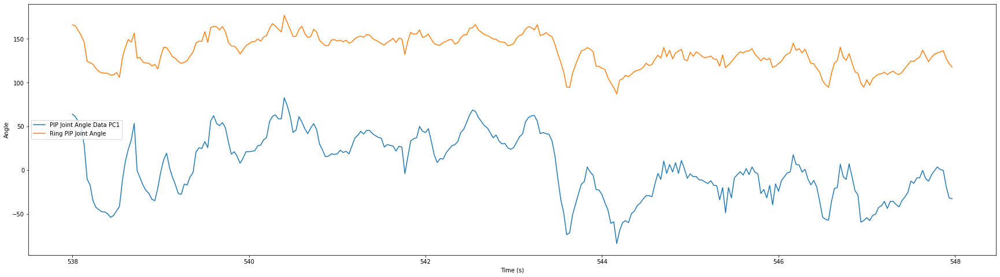

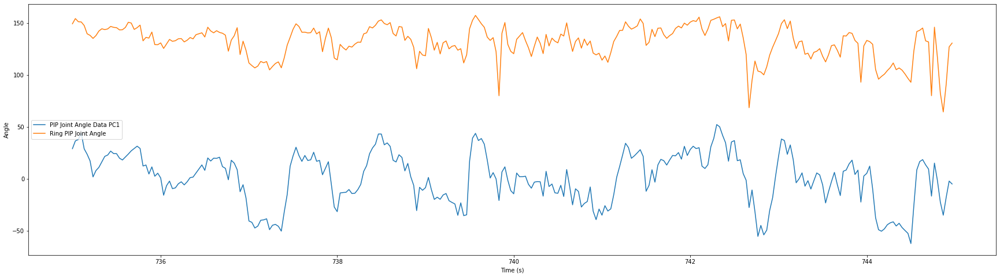

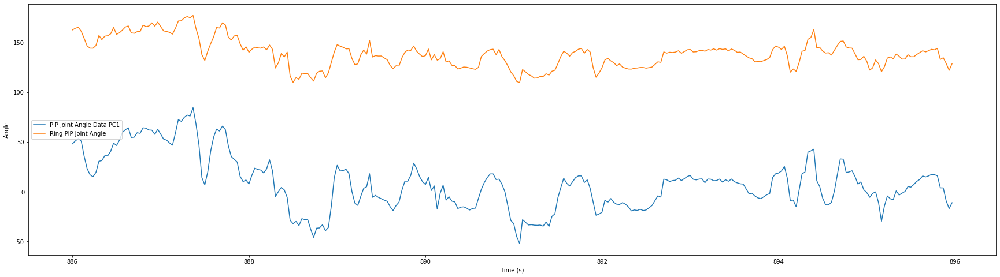

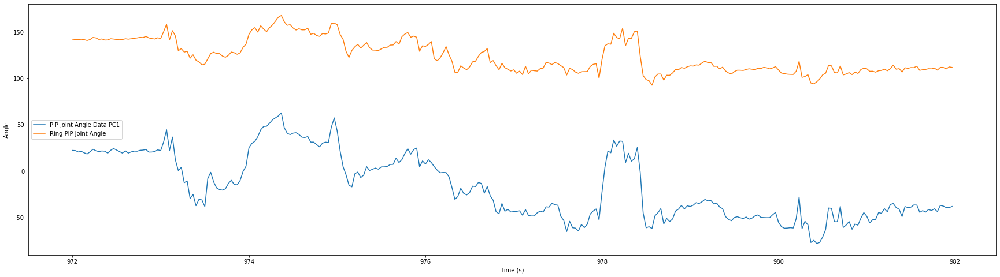

In [23]:
for i in range(len(ranges)):    
    plt.figure(figsize=(30,8))
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    plt.plot(xaxis_seconds, pip_angle_pc1[i*300:(i+1)*300])
    plt.plot(xaxis_seconds, pip_joints_segments[i*300:(i+1)*300,1])
    plt.xlabel('Time (s)')
    plt.ylabel('Angle')
    plt.legend(['PIP Joint Angle Data PC1','Ring PIP Joint Angle'], loc = 'center left')
    plt.show()

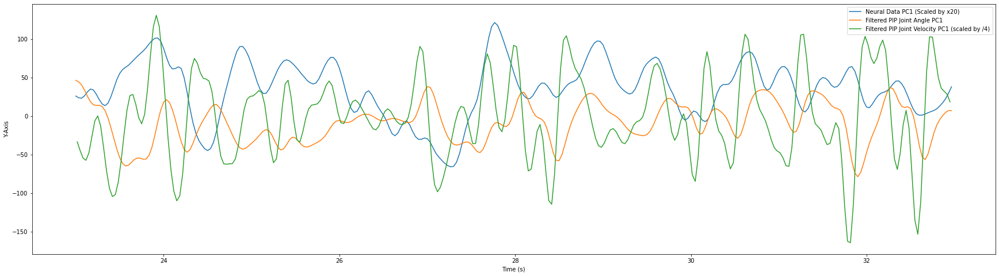

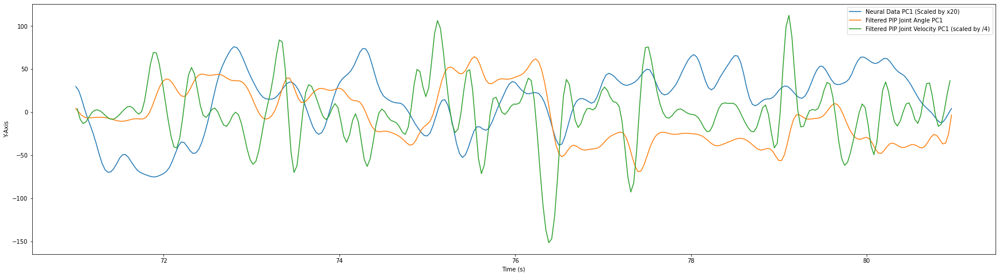

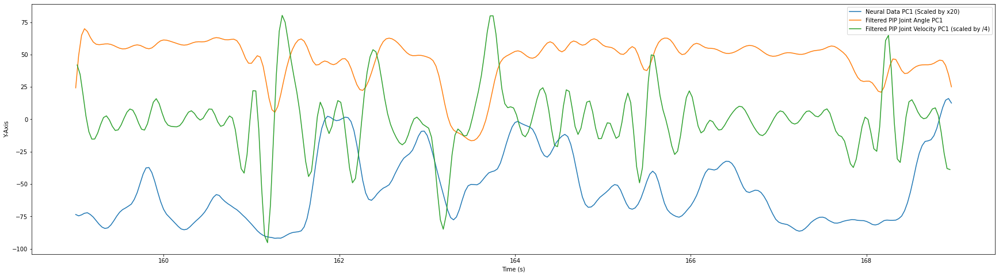

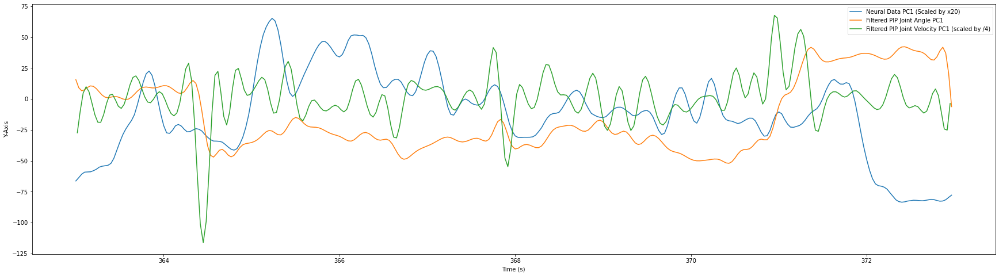

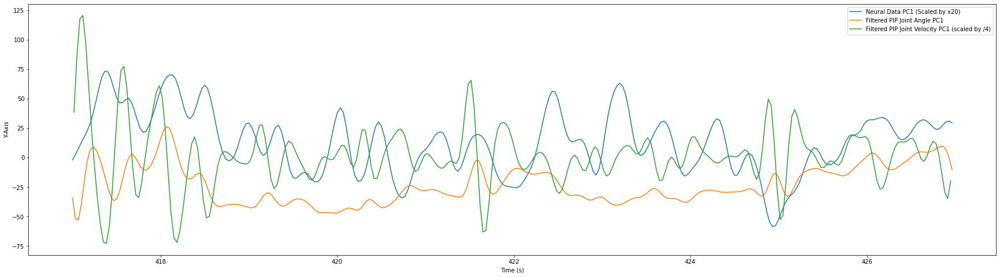

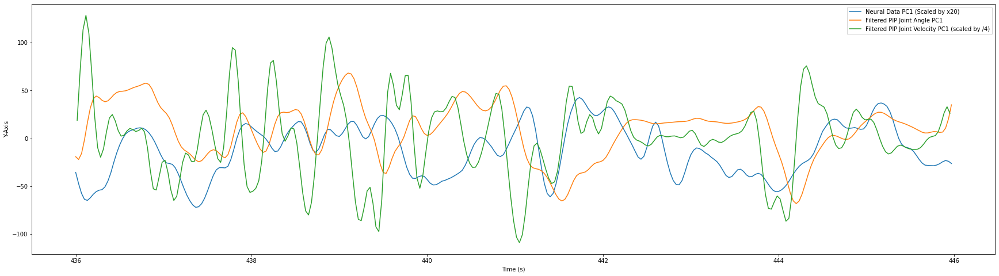

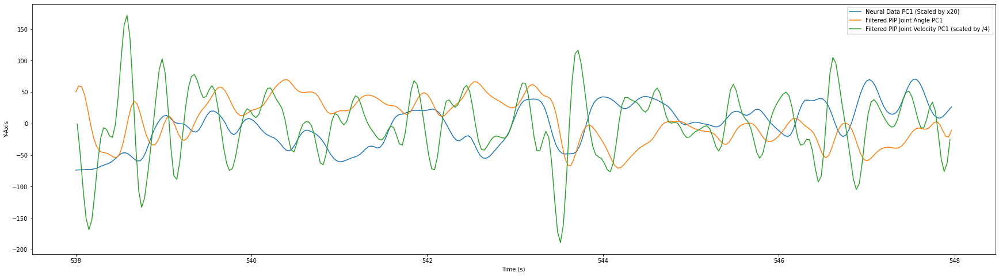

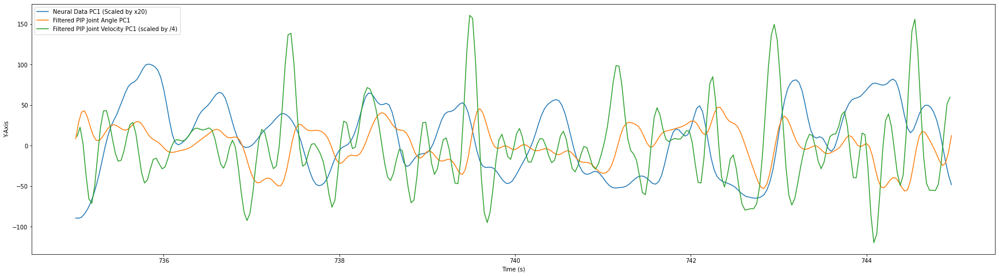

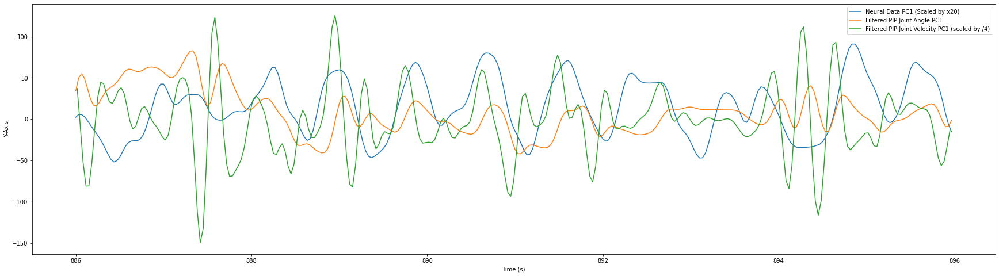

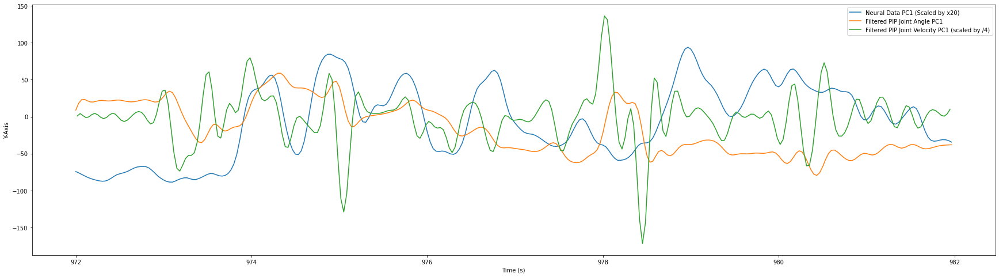

In [24]:
  for i in range(len(ranges)):
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    x2 = (xaxis_seconds[:-1] + xaxis_seconds[1:]) / 2

    plt.figure(figsize=(30,8))
    plt.plot(xaxis_seconds, neural_pc1[i*300:(i+1)*300]*20)
    plt.plot(xaxis_seconds, filtered_pip_angle_pc1[i*300:(i+1)*300])
    plt.plot(x2, filtered_pip_velocity_pc1[i*299:(i+1)*299]/4)
    plt.xlabel('Time (s)')
    plt.ylabel('Y-Axis')
    plt.legend(['Neural Data PC1 (Scaled by x20)', 'Filtered PIP Joint Angle PC1', 'Filtered PIP Joint Velocity PC1 (scaled by /4)'])
    plt.show()

## PCA Analysis - DIP Joints

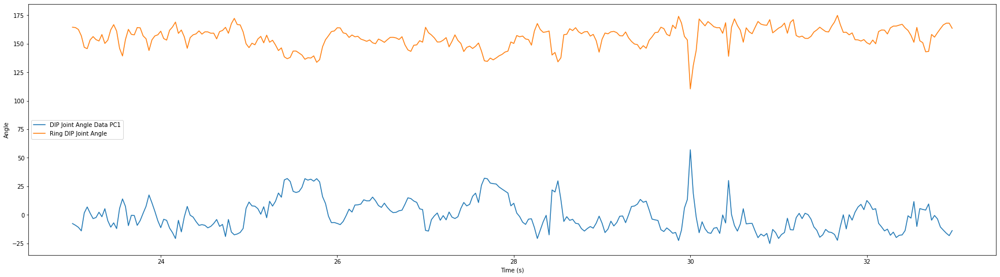

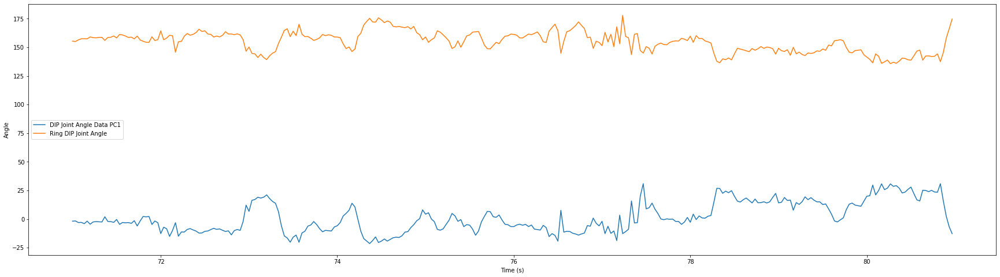

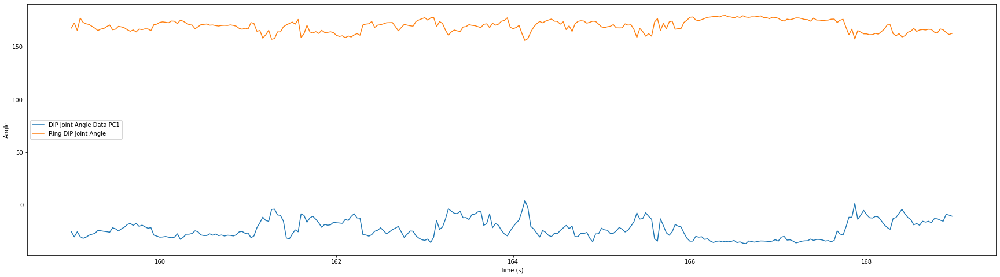

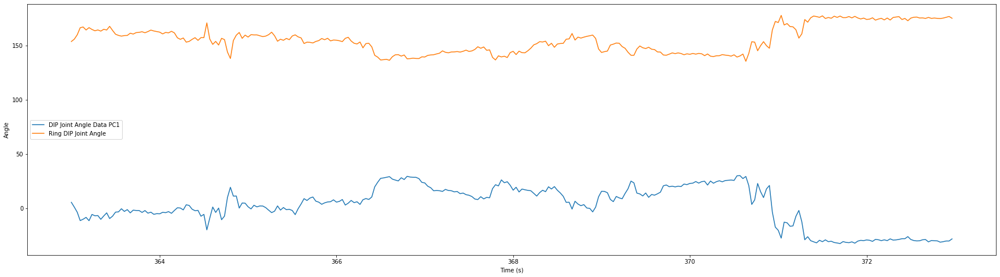

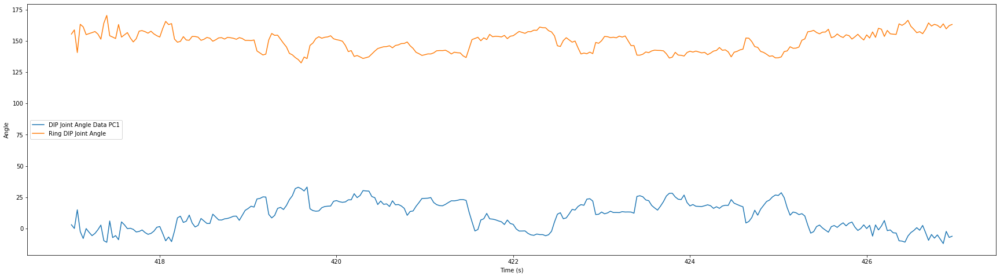

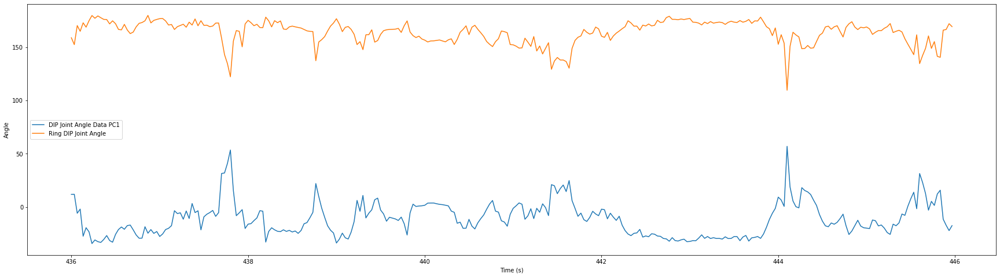

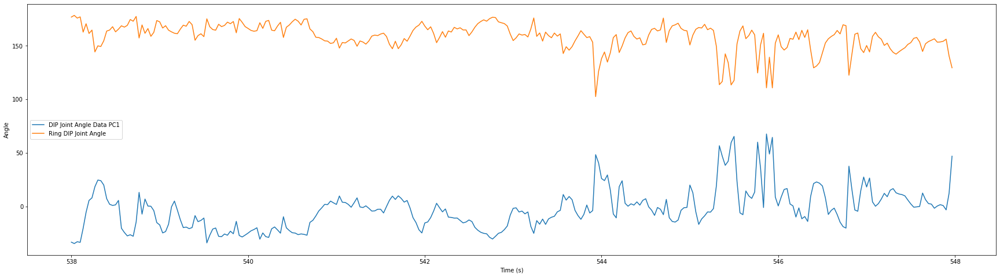

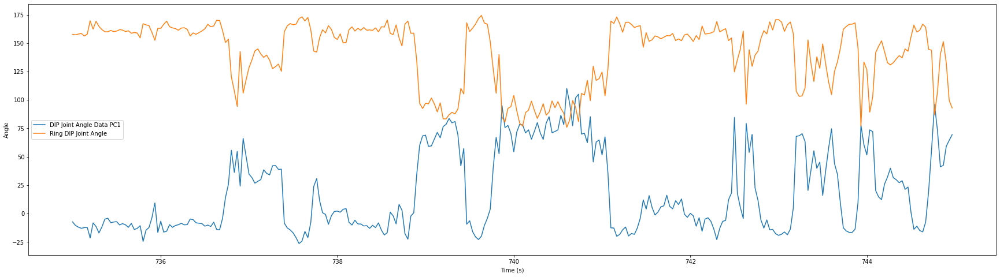

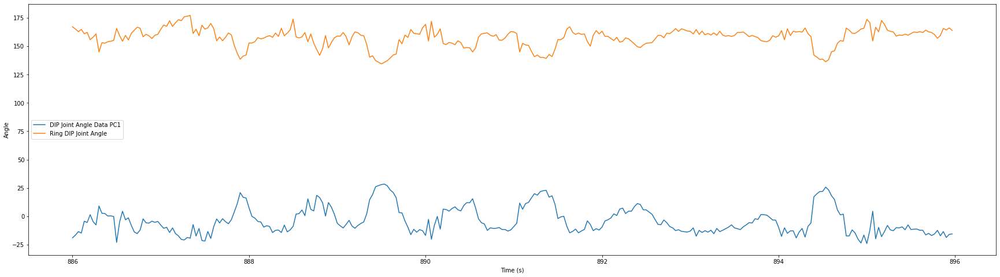

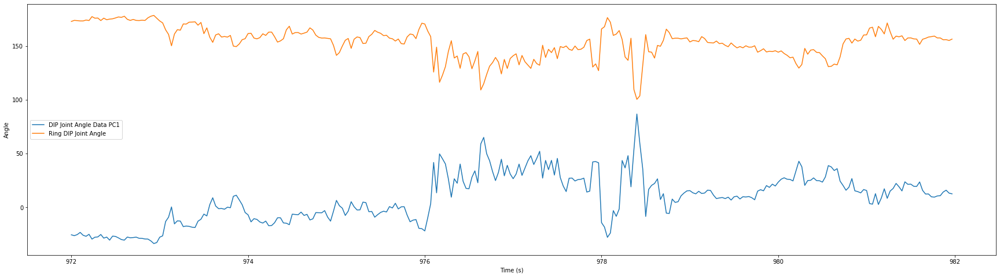

In [25]:
for i in range(len(ranges)):    
    plt.figure(figsize=(30,8))
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    plt.plot(xaxis_seconds, dip_angle_pc1[i*300:(i+1)*300])
    plt.plot(xaxis_seconds, dip_joints_segments[i*300:(i+1)*300,1])
    plt.xlabel('Time (s)')
    plt.ylabel('Angle')
    plt.legend(['DIP Joint Angle Data PC1','Ring DIP Joint Angle'], loc = 'center left')
    plt.show()

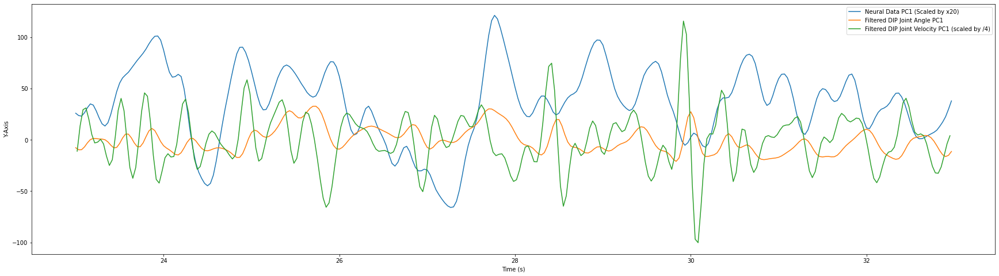

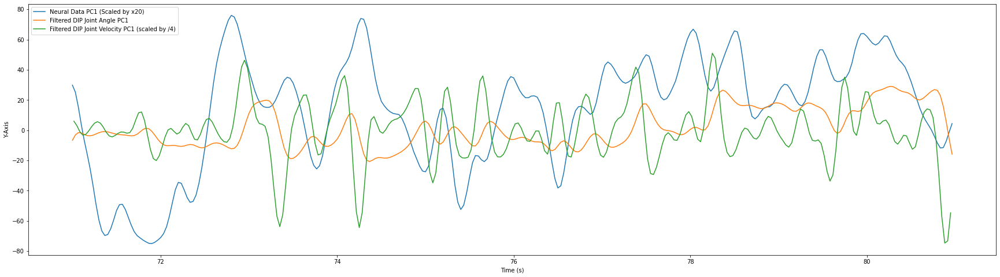

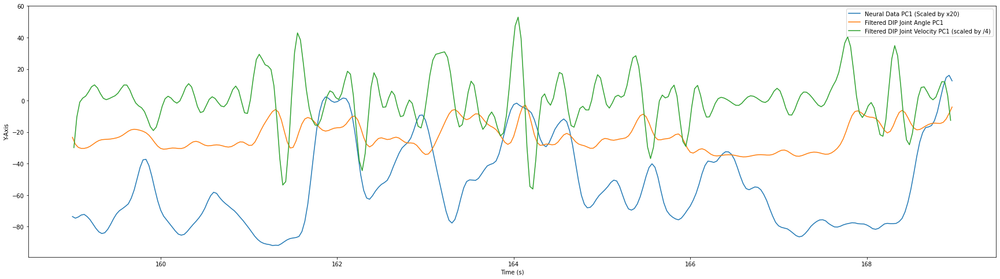

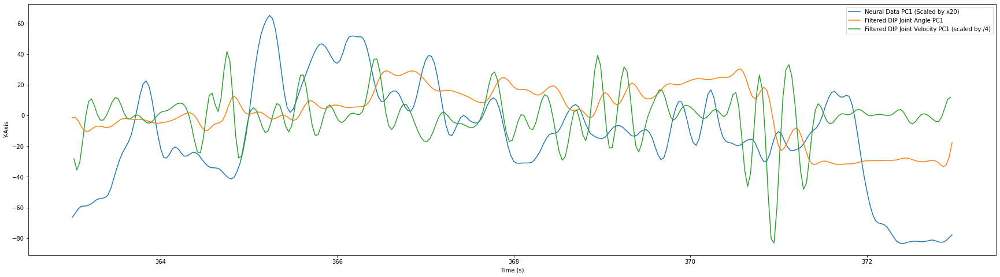

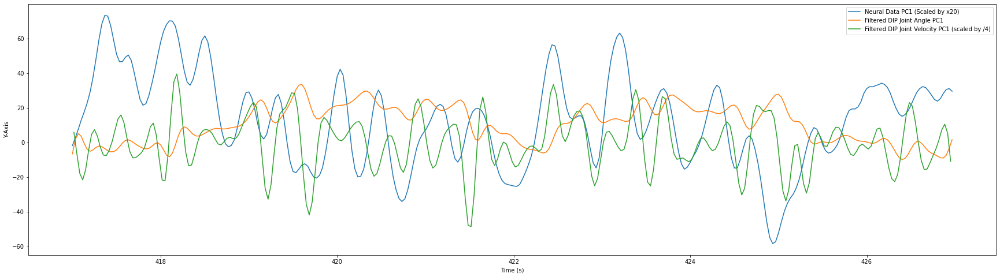

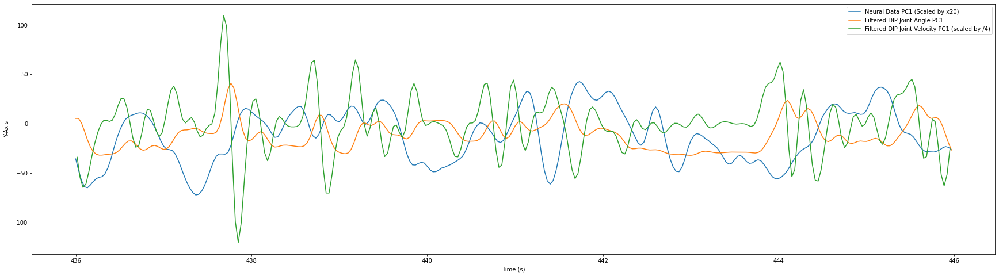

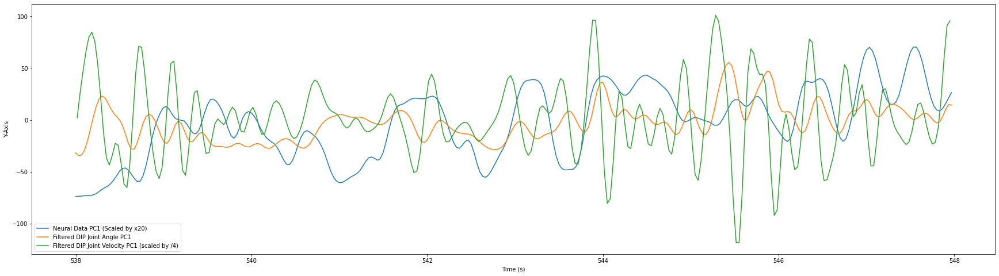

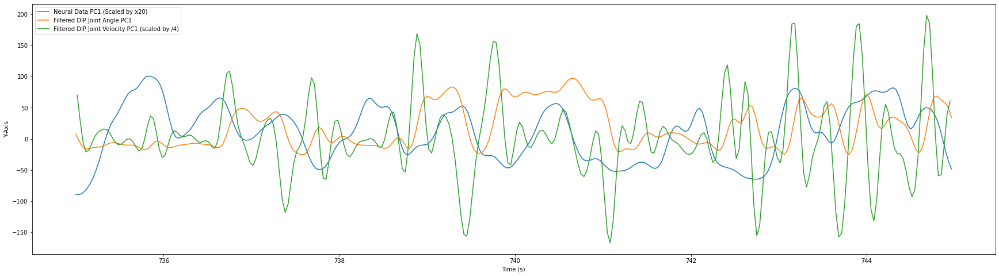

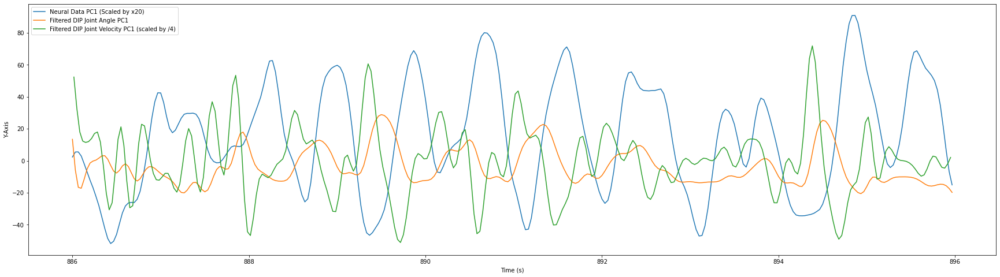

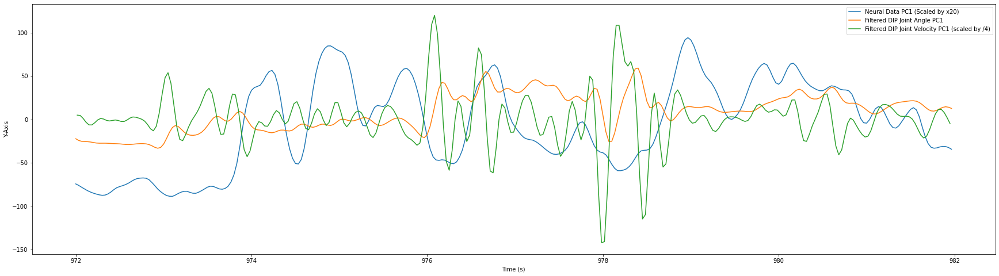

In [26]:
for i in range(len(ranges)):
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    x2 = (xaxis_seconds[:-1] + xaxis_seconds[1:]) / 2

    plt.figure(figsize=(30,8))
    plt.plot(xaxis_seconds, neural_pc1[i*300:(i+1)*300]*20)
    plt.plot(xaxis_seconds, filtered_dip_angle_pc1[i*300:(i+1)*300])
    plt.plot(x2, filtered_dip_velocity_pc1[i*299:(i+1)*299]/4)
    plt.xlabel('Time (s)')
    plt.ylabel('Y-Axis')
    plt.legend(['Neural Data PC1 (Scaled by x20)', 'Filtered DIP Joint Angle PC1', 'Filtered DIP Joint Velocity PC1 (scaled by /4)'])
    plt.show()

## PCA Analysis - Hinge Joints

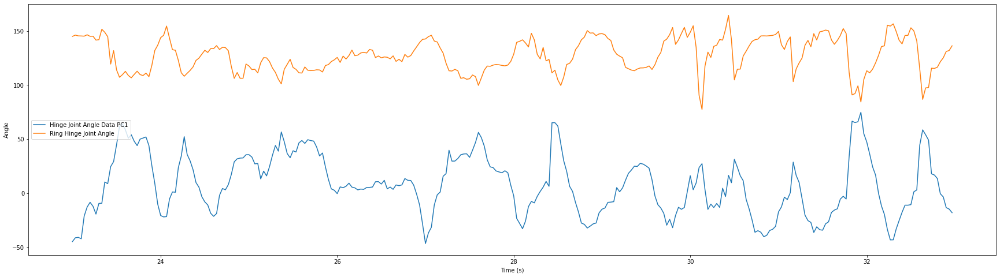

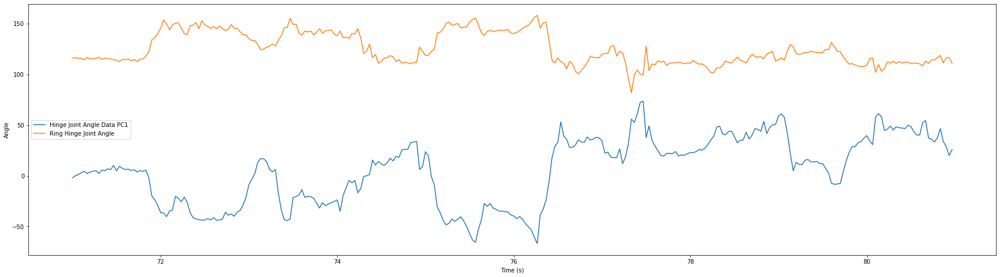

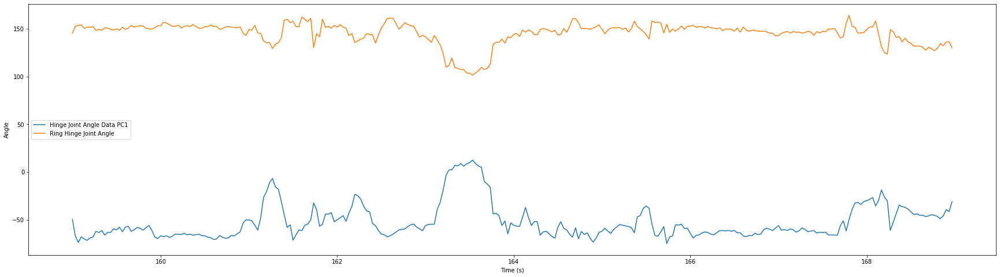

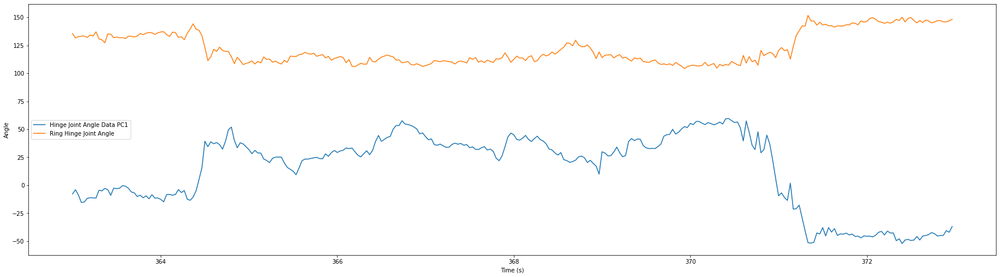

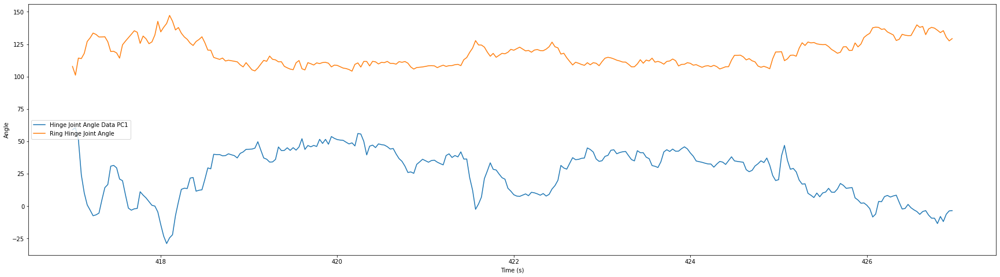

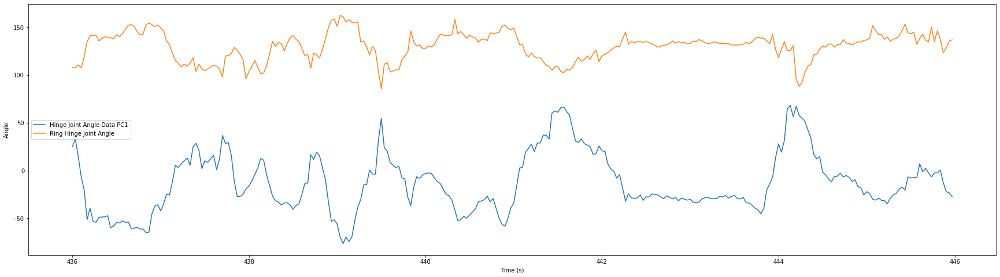

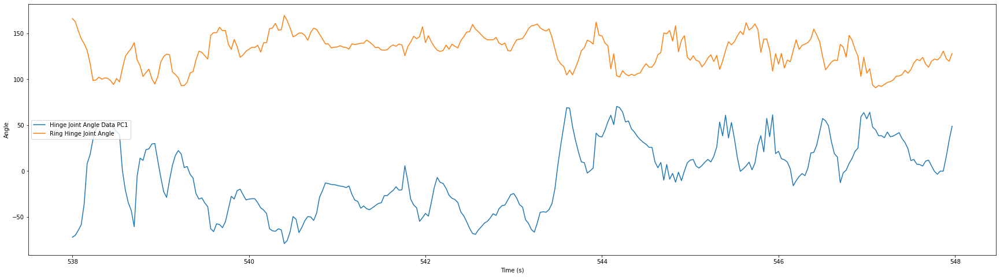

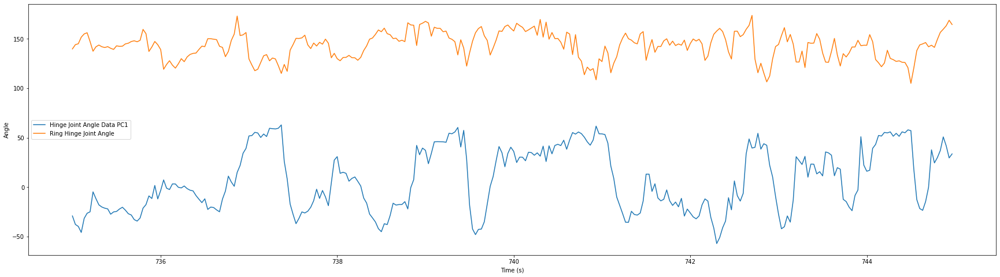

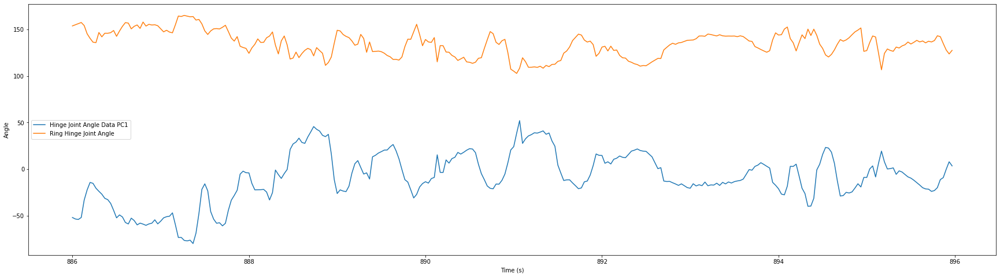

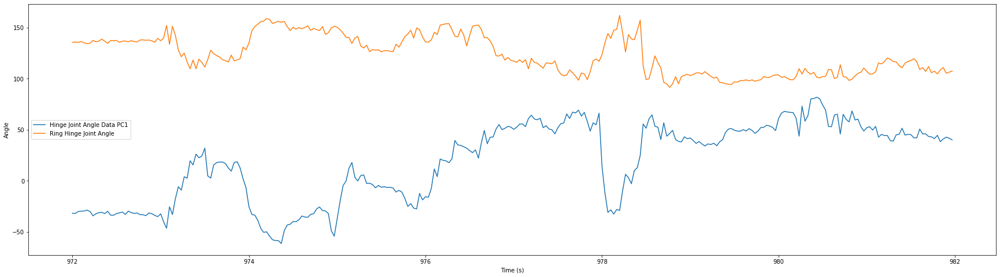

In [27]:
for i in range(len(ranges)):    
    plt.figure(figsize=(30,8))
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    plt.plot(xaxis_seconds, hinge_angle_pc1[i*300:(i+1)*300])
    plt.plot(xaxis_seconds, hinge_joints_segments[i*300:(i+1)*300,1])
    plt.xlabel('Time (s)')
    plt.ylabel('Angle')
    plt.legend(['Hinge Joint Angle Data PC1','Ring Hinge Joint Angle'], loc = 'center left')
    plt.show()

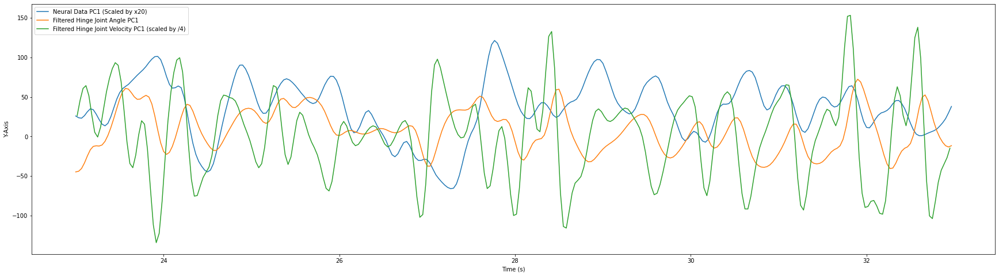

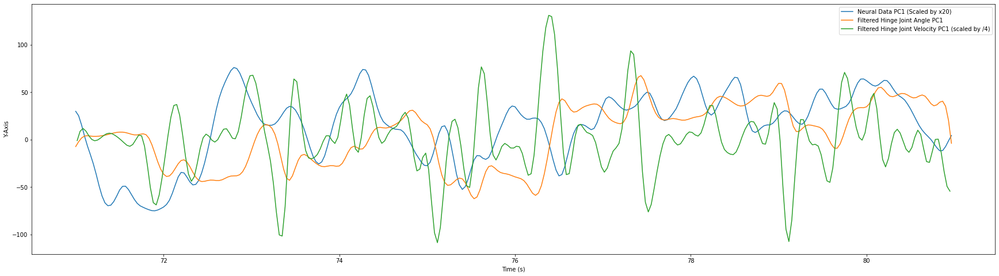

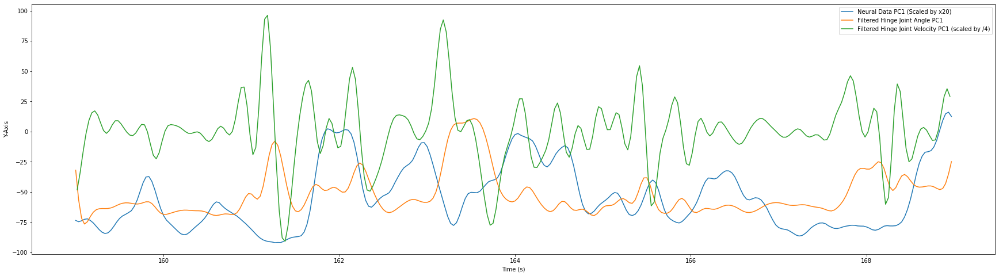

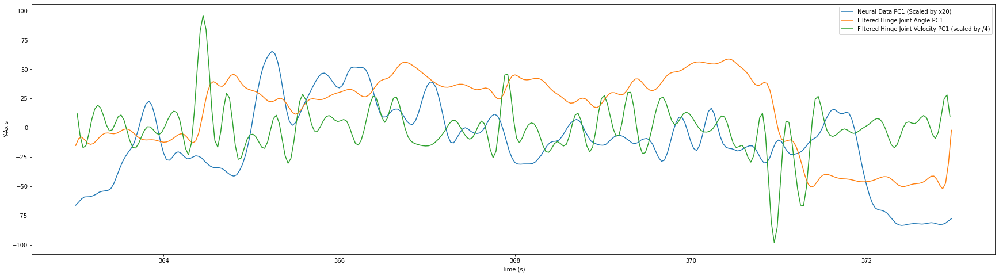

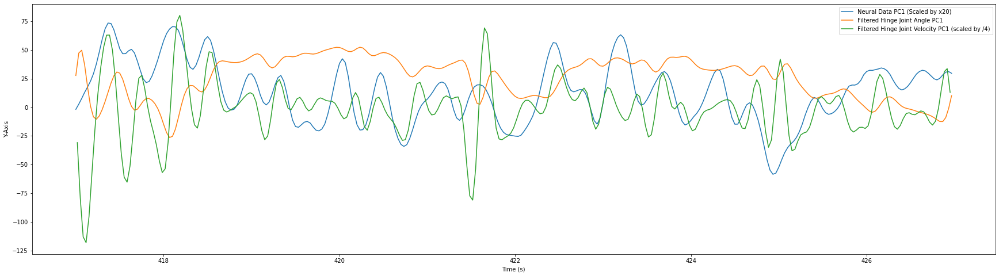

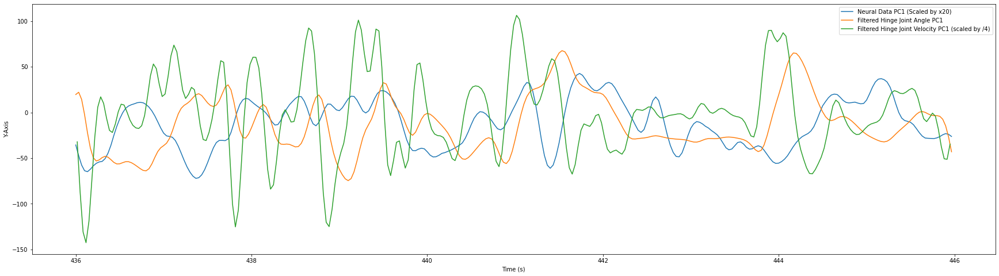

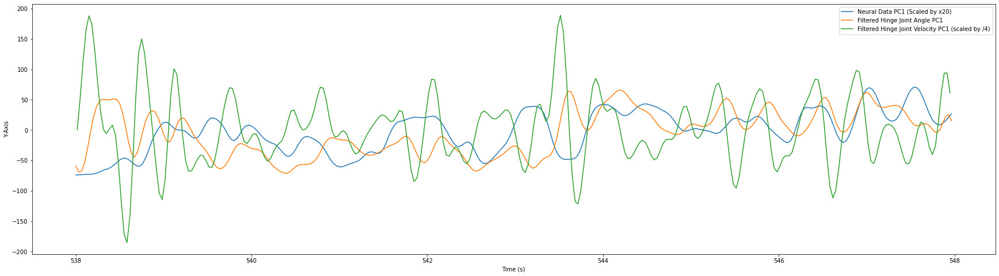

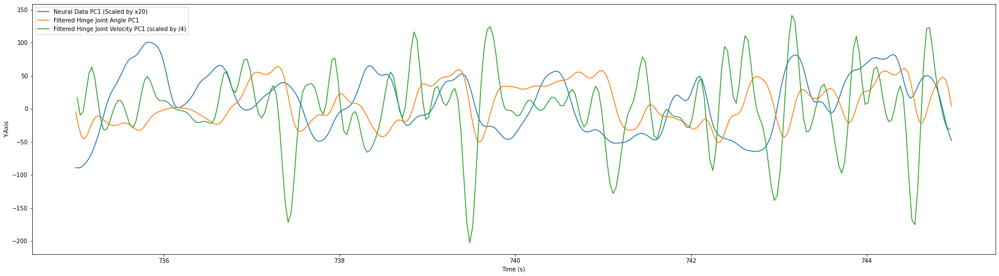

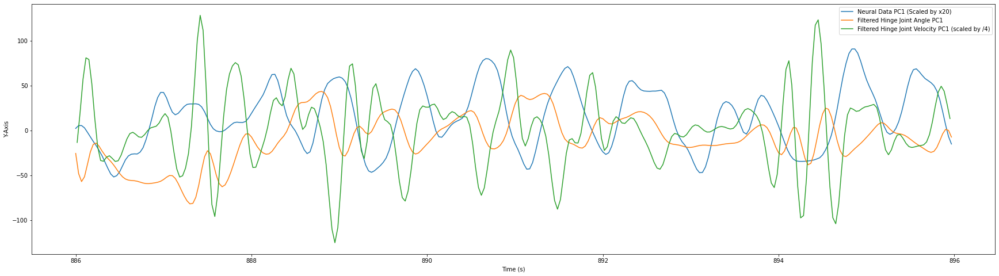

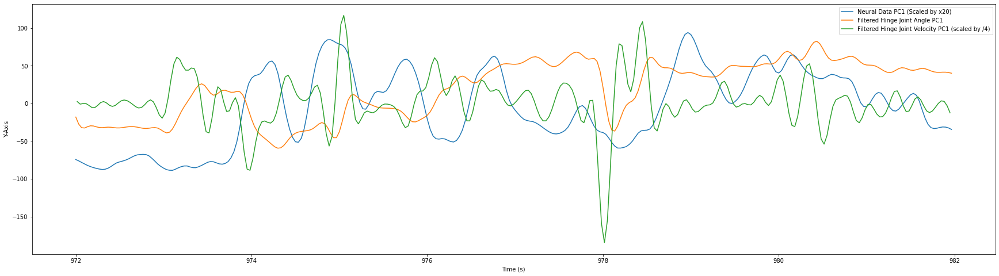

In [30]:
pca_array = np.zeros((299, 3, 10))
for i in range(len(ranges)):
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    x2 = (xaxis_seconds[:-1] + xaxis_seconds[1:]) / 2
    
    pca_array[:,0,i] += neural_pc1[i*300:(i+1)*300-1]
    pca_array[:,1,i] += filtered_hinge_angle_pc1[i*300:(i+1)*300-1]
    pca_array[:,2,i] += filtered_hinge_velocity_pc1[i*299:(i+1)*299]

    plt.figure(figsize=(30,8))
    plt.plot(xaxis_seconds, neural_pc1[i*300:(i+1)*300]*20)
    plt.plot(xaxis_seconds, filtered_hinge_angle_pc1[i*300:(i+1)*300])
    plt.plot(x2, filtered_hinge_velocity_pc1[i*299:(i+1)*299]/4)
    plt.xlabel('Time (s)')
    plt.ylabel('Y-Axis')
    plt.legend(['Neural Data PC1 (Scaled by x20)', 'Filtered Hinge Joint Angle PC1', 'Filtered Hinge Joint Velocity PC1 (scaled by /4)'])
    plt.show()

Save numpy arrays to csv

In [31]:
from scipy import io as scio
scio.savemat('/Users/aajanquail/Downloads/20210712_pca_arrays.mat', {'pca_array': pca_array})

In [24]:
filtered_ring_pip_joint = scipy.signal.filtfilt(b, a, pip_joints_segments.flatten())
ring_pip_joint_array = np.zeros((299,2,10))
for i in range(len(ranges)):
    xaxis_seconds = np.arange(ranges[i][0],ranges[i][1])/30
    x2 = (xaxis_seconds[:-1] + xaxis_seconds[1:]) / 2
    der = np.diff(filtered_ring_pip_joint[i*300:(i+1)*300]) / np.diff(xaxis_seconds)
    
    ring_pip_joint_array[:,0,r] += filtered_ring_pip_joint[i*300:(i+1)*300-1].flatten()
    ring_pip_joint_array[:,1,r] += der.flatten()

(12000,)


In [26]:
scio.savemat('/Users/aajanquail/Downloads/20210712_ring_pip_joint_array.mat', {'ring_pip_joint_array': ring_pip_joint_array})

### Aajan's Original Data Segment

In [33]:
neural_data_seg_original = neural_data['units_smoothed'][:,720:2520].T
hinge_joints_segment_original = angles[720:2520,:4,:2].reshape(-1,8)

In [34]:
neural_data_seg_original.shape, hinge_joints_segment_original.shape

((1800, 142), (1800, 8))

In [35]:
pca_hinge_og = PCA(n_components=1)
hinge_angle_pc1_og = pca_hinge.fit_transform(hinge_joints_segment_original)

In [43]:
x_axis_time = np.arange(1800)
hinge_velocity_pc1_og = np.diff(hinge_angle_pc1_og.flatten())/np.diff(x_axis_time)

In [44]:
hinge_velocity_pc1_og.shape

(1799,)

In [46]:
filtered_hinge_angle_pc1_og = scipy.signal.filtfilt(b, a, hinge_angle_pc1_og.flatten())
filtered_hinge_velocity_pc1_og = scipy.signal.filtfilt(b, a, hinge_velocity_pc1_og.flatten())

In [38]:
pca_neural_og = PCA(n_components=1)
neural_pc1_og = pca_neural.fit_transform(neural_data['units_smoothed'][:,720:2520].T)

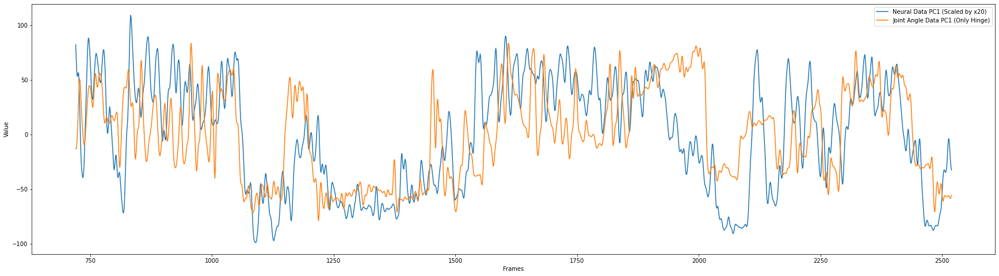

In [39]:
plt.figure(figsize=(30,8))
plt.plot(np.arange(720,2520),neural_pc1_og*20)
plt.plot(np.arange(720,2520),filtered_hinge_angle_pc1_og)
plt.legend(['Neural Data PC1 (Scaled by x20)', 'Joint Angle Data PC1 (Only Hinge)'])
plt.xlabel('Frames')
plt.ylabel('Value')
plt.show()

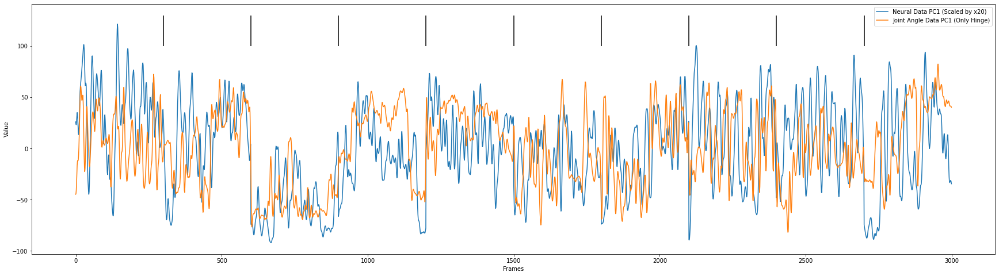

In [40]:
plt.figure(figsize=(30,8))
plt.plot(neural_pc1*20)
plt.plot(filtered_hinge_angle_pc1)
plt.vlines([300,600,900,1200,1500,1800,2100,2400,2700], 100, 130, colors='black',)
plt.legend(['Neural Data PC1 (Scaled by x20)', 'Joint Angle Data PC1 (Only Hinge)', 'Segment Borders'])
plt.xlabel('Frames')
plt.ylabel('Value')
plt.show()

In [50]:
filtered_hinge_angle_pc1.shape, filtered_hinge_angle_pc1[np.r_[0:299,300:599,600:899,900:1199,1200:1499,1500:1799]].shape

((3000,), (1794,))

In [51]:
filtered_hinge_velocity_pc1.shape

(2990,)

In [52]:
scio.savemat('/Users/aajanquail/Downloads/20210712_neural_pc1.mat', {'neural_pc1': neural_pc1[np.r_[0:299,300:599,600:899,900:1199,1200:1499,1500:1799,1800:2099,2100:2399,2400:2699,2700:2999]]})
scio.savemat('/Users/aajanquail/Downloads/20210712_filtered_hinge_angle_pc1.mat', {'filtered_hinge_angle_pc1': filtered_hinge_angle_pc1[np.r_[0:299,300:599,600:899,900:1199,1200:1499,1500:1799,1800:2099,2100:2399,2400:2699,2700:2999]]})
scio.savemat('/Users/aajanquail/Downloads/20210712_filtered_hinge_velocity_pc1.mat', {'filtered_hinge_velocity_pc1': filtered_hinge_velocity_pc1})
scio.savemat('/Users/aajanquail/Downloads/20210712_neural_pc1_og.mat', {'neural_pc1_og': neural_pc1_og[:-1]})
scio.savemat('/Users/aajanquail/Downloads/20210712_filtered_hinge_angle_pc1_og.mat', {'filtered_hinge_angle_pc1_og': filtered_hinge_angle_pc1_og[:-1]})
scio.savemat('/Users/aajanquail/Downloads/20210712_filtered_hinge_velocity_pc1_og.mat', {'filtered_hinge_velocity_pc1_og': filtered_hinge_velocity_pc1_og})

## Filtering - Butterworth

In [58]:
mcp_joints[:,0].shape

(37439,)

In [59]:
# apply a 3-pole lowpass filter at 0.1x Nyquist frequency
import scipy
b, a = scipy.signal.butter(4, 0.33)
filtered = scipy.signal.filtfilt(b, a, mcp_joints[:,0])

In [60]:
bottom_limit = 720
upper_limit = 1020
xaxis_seconds = np.arange(bottom_limit,upper_limit)/30

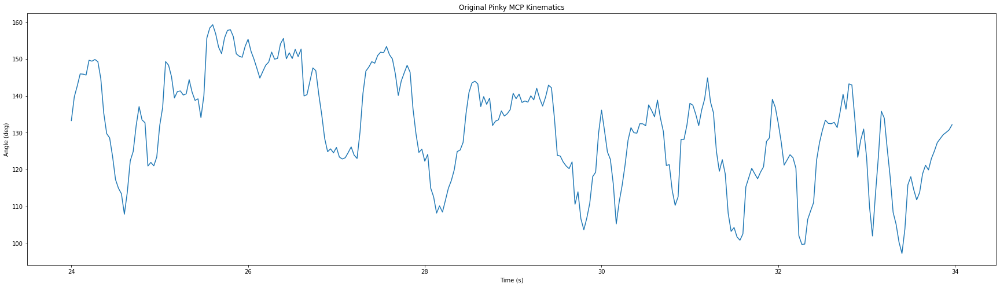

In [61]:
plt.figure(figsize=(30,8))
plt.plot(xaxis_seconds, mcp_joints[bottom_limit:upper_limit,0])
plt.title('Original Pinky MCP Kinematics')
plt.xlabel('Time (s)')
plt.ylabel('Angle (deg)')
plt.show()

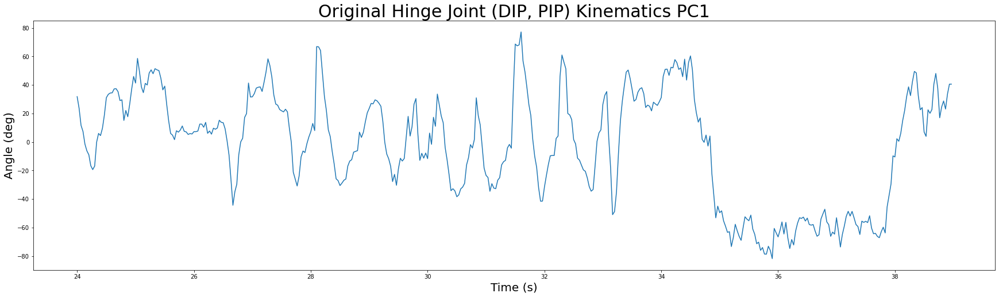

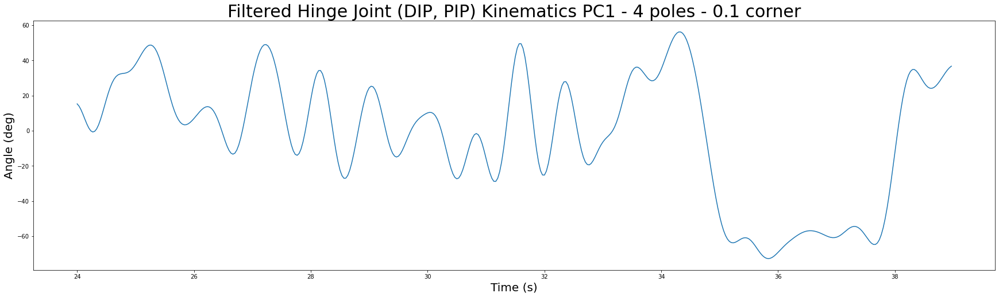

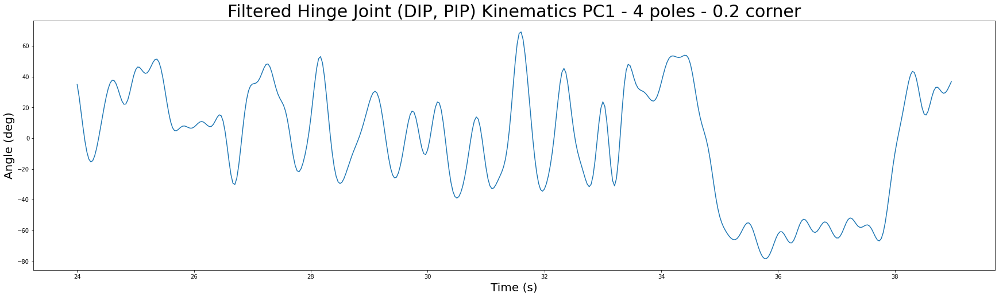

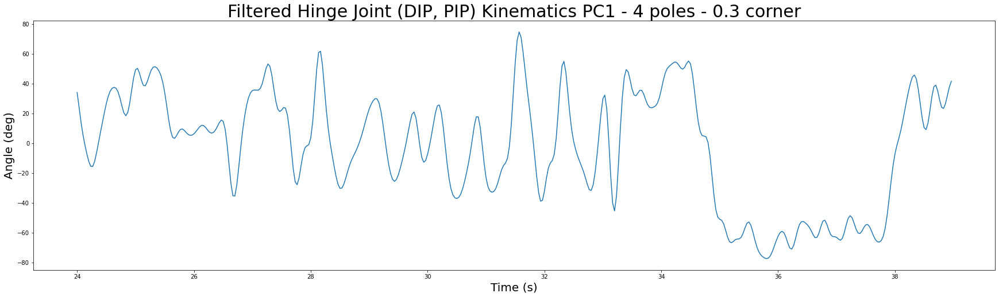

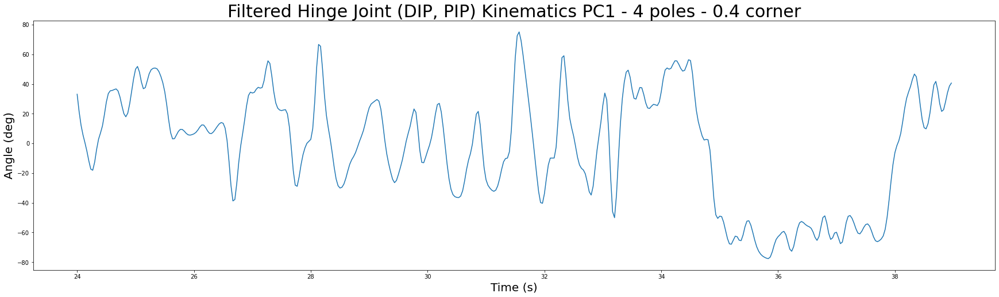

...

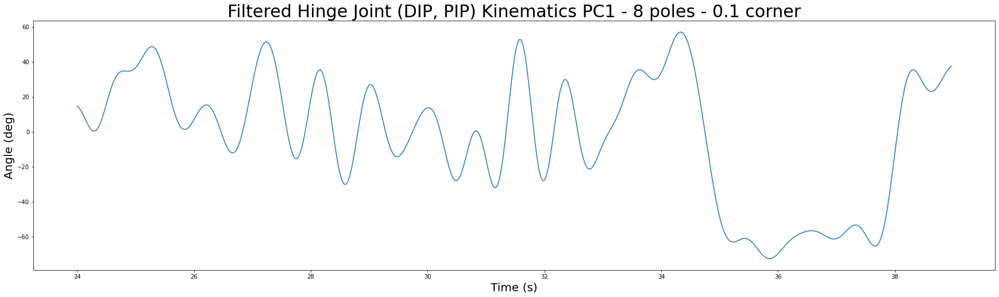

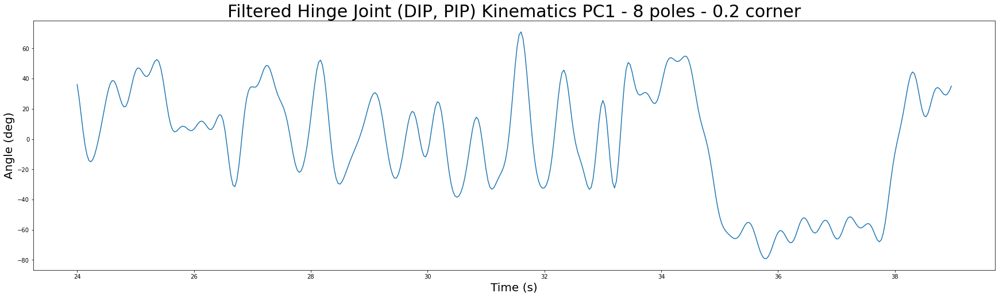

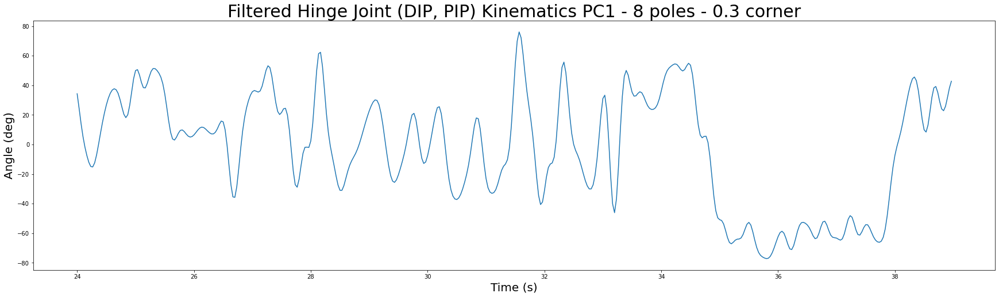

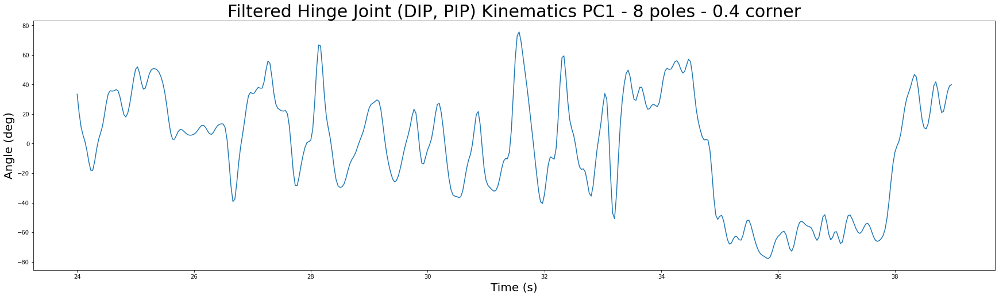

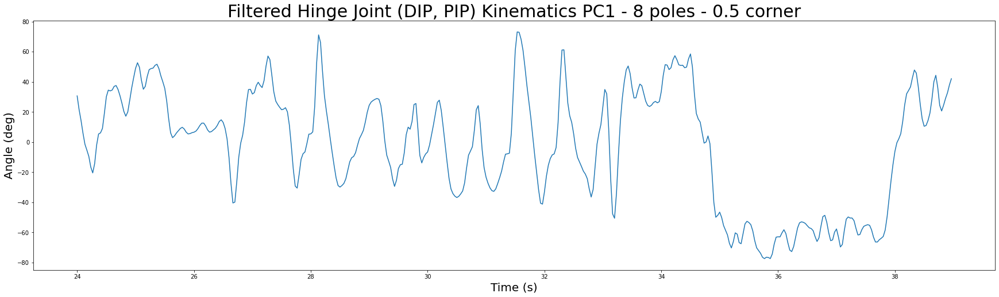

In [62]:
bottom_limit = 720
upper_limit = 1170
xaxis_seconds = np.arange(bottom_limit,upper_limit)/30

orders = [4,5,6,7,8]
corners = [0.1,0.2,0.3,0.4,0.5]

plt.figure(figsize=(30,8))
plt.plot(xaxis_seconds, pca_hinge_features[bottom_limit:upper_limit,0])
plt.title('Original Hinge Joint (DIP, PIP) Kinematics PC1', fontsize = 30)
plt.xlabel('Time (s)', fontsize = 20)
plt.ylabel('Angle (deg)', fontsize = 20)
plt.show()

for order in orders:
    for corner in corners:
        b, a = scipy.signal.butter(order, corner)
        filtered = scipy.signal.filtfilt(b, a, pca_hinge_features[:,0])
        
        plt.figure(figsize=(30,8))
        plt.plot(xaxis_seconds, filtered[bottom_limit:upper_limit])
        tit = 'Filtered Hinge Joint (DIP, PIP) Kinematics PC1 - ' +str(order)+ ' poles - ' +str(corner)+ ' corner'
        plt.title(tit, fontsize = 30)
        plt.xlabel('Time (s)', fontsize = 20)
        plt.ylabel('Angle (deg)', fontsize = 20)
        plt.show()

In [68]:
pca_mcp_features.shape, pca_mcp_features.flatten().shape, pip_joints[:,3].shape

((37439, 1), (37439,), (37439,))

In [71]:
pca_mcp_features.shape

(37439,)

In [75]:
angles.shape

(37439, 5, 3)

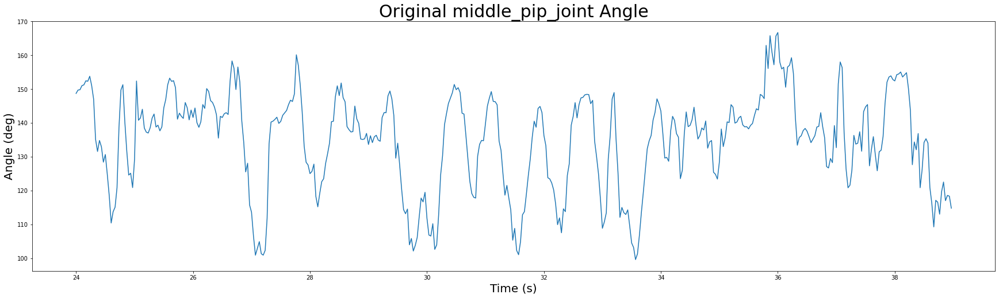

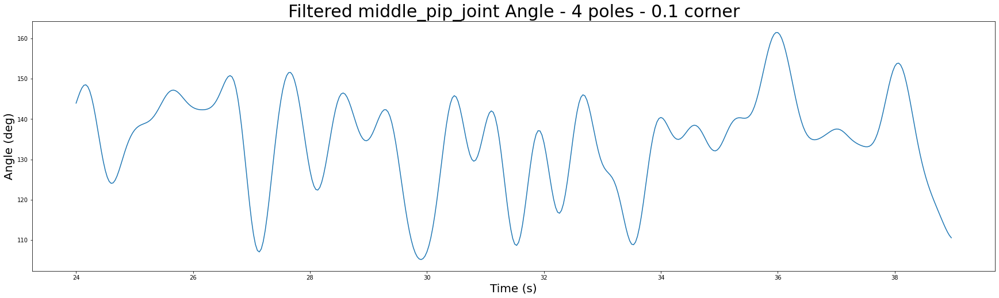

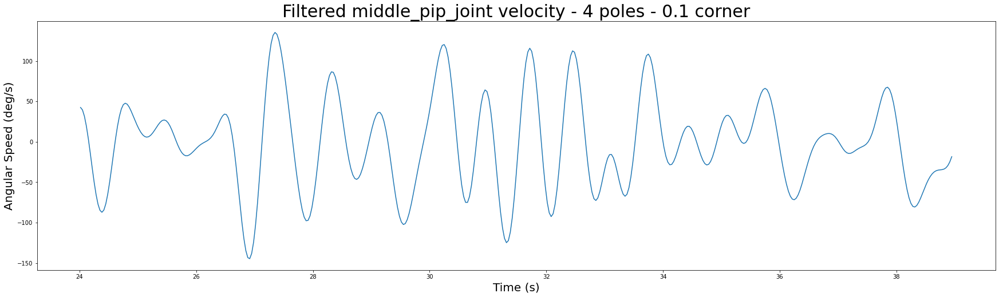

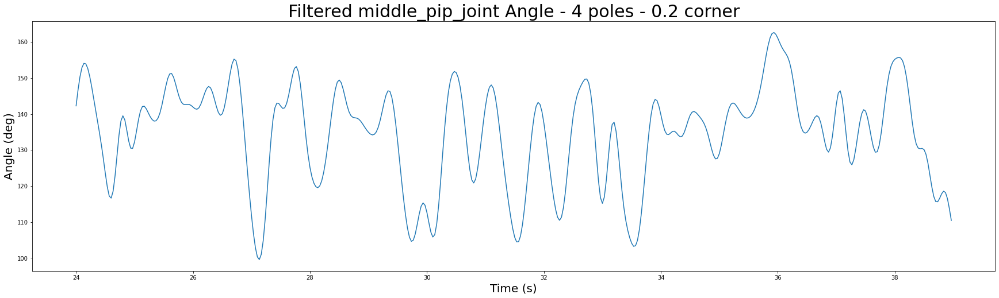

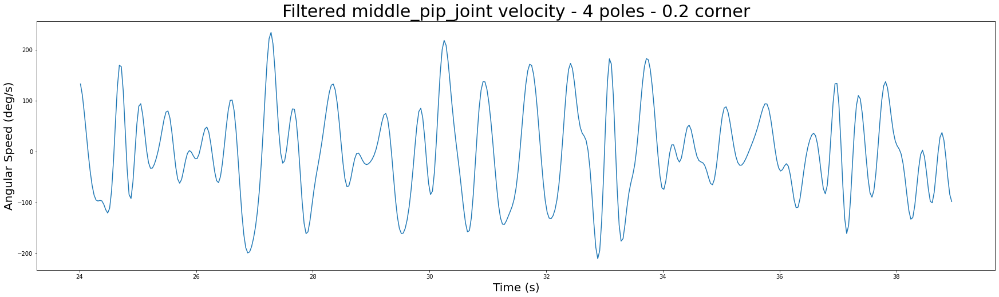

...

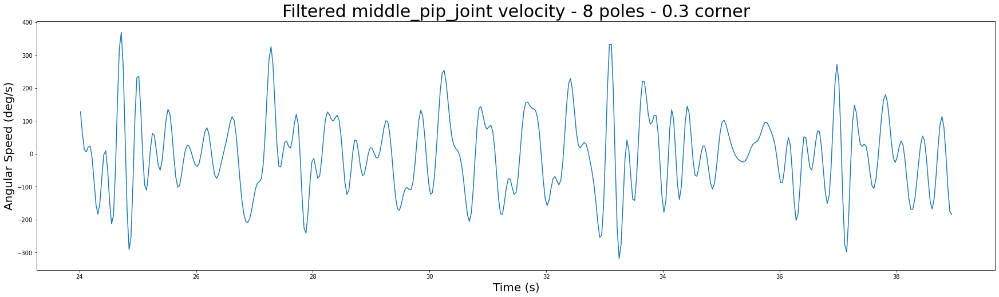

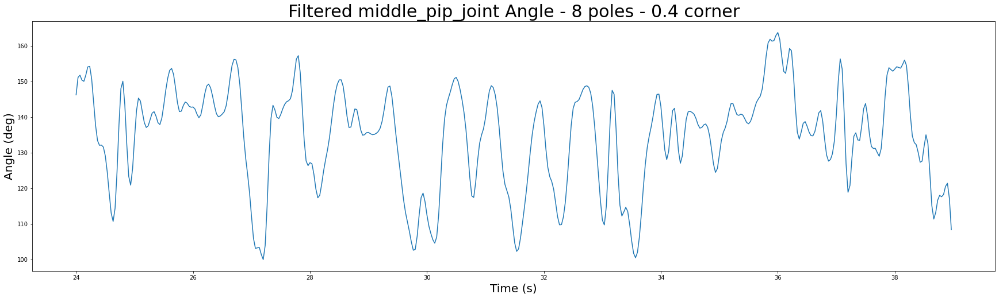

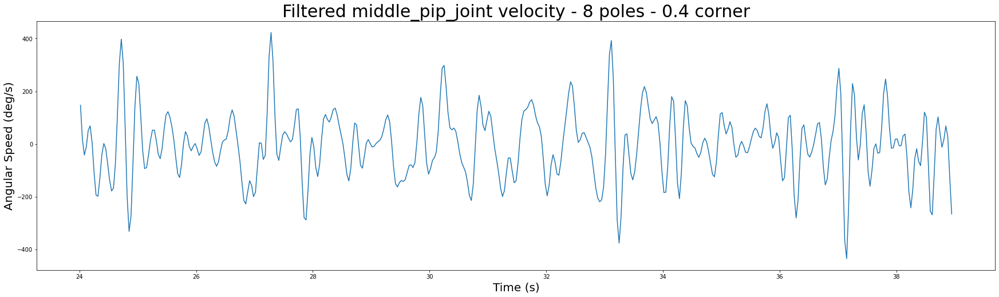

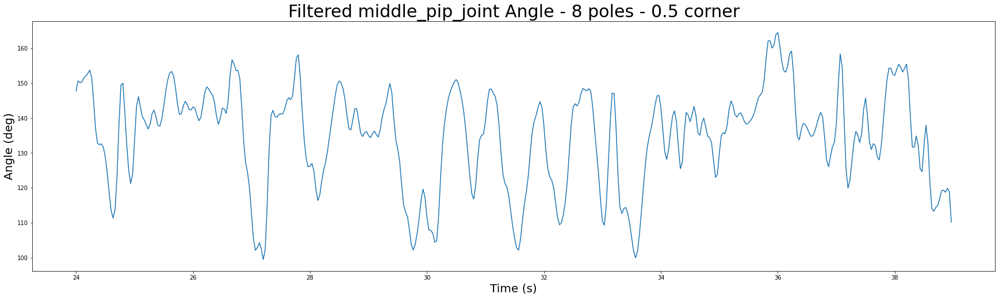

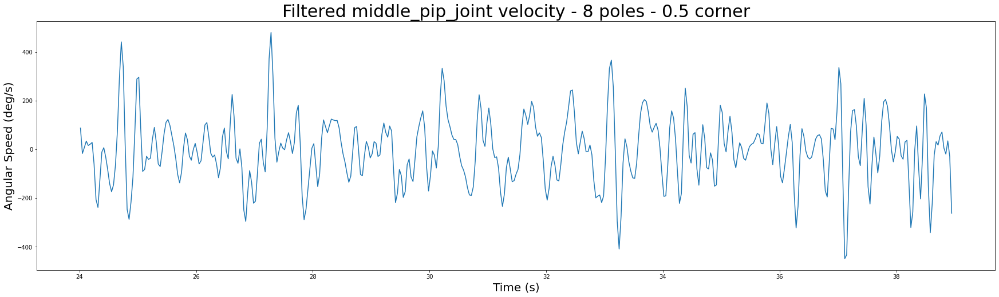

In [78]:
bottom_limit = 720
upper_limit = 1170
xaxis_seconds = np.arange(bottom_limit,upper_limit)/30
middle_pip_joint = angles[:,3,2]
# pca_mcp_features = pca_mcp_features.flatten()

orders = [4,5,6,7,8]
corners = [0.1,0.2,0.3,0.4,0.5]

plt.figure(figsize=(30,8))
plt.plot(xaxis_seconds, middle_pip_joint[bottom_limit:upper_limit])
plt.title('Original middle_pip_joint Angle', fontsize = 30)
plt.xlabel('Time (s)', fontsize = 20)
plt.ylabel('Angle (deg)', fontsize = 20)
plt.show()

for order in orders:
    for corner in corners:
        b, a = scipy.signal.butter(order, corner)
        filtered = scipy.signal.filtfilt(b, a, middle_pip_joint)
        
        plt.figure(figsize=(30,8))
        plt.plot(xaxis_seconds, filtered[bottom_limit:upper_limit])
        tit = 'Filtered middle_pip_joint Angle - ' +str(order)+ ' poles - ' +str(corner)+ ' corner'
        plt.title(tit, fontsize = 30)
        plt.xlabel('Time (s)', fontsize = 20)
        plt.ylabel('Angle (deg)', fontsize = 20)
        plt.show()
        
        der = np.diff(filtered[bottom_limit:upper_limit]) / np.diff(xaxis_seconds)
        x2 = (xaxis_seconds[:-1] + xaxis_seconds[1:]) / 2
        plt.figure(figsize=(30,8))
        plt.plot(x2, der)
        tit = 'Filtered middle_pip_joint velocity - ' +str(order)+ ' poles - ' +str(corner)+ ' corner'
        plt.title(tit, fontsize = 30)
        plt.xlabel('Time (s)', fontsize = 20)
        plt.ylabel('Angular Speed (deg/s)', fontsize = 20)
        plt.show()
        if ((order == 4) and (corner == 0.3)):
            np.savetxt('/Users/aajanquail/Downloads/0712_middle_pip_joint_velocity_butterworth_4poles_03corner.txt', der, delimiter=',')
            np.savetxt('/Users/aajanquail/Downloads/0712_middle_pip_joint_angle_butterworth_4poles_03corner.txt', filtered[bottom_limit:upper_limit], delimiter=',')

## --------------------------------------------------------------------------------

# TSNE

In [29]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components = 2)
tsne_result_angles_reshaped = tsne.fit_transform(angles_reshaped)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:805: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


In [30]:
tsne_result_angles_reshaped.shape

(18547, 2)

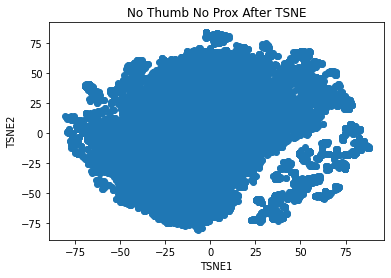

In [31]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.scatter(tsne_result_angles_reshaped[:,0], tsne_result_angles_reshaped[:,1])
ax.set_xlabel('TSNE1')
ax.set_ylabel('TSNE2')
ax.set_title('No Thumb No Prox After TSNE')
plt.show()

# UMAP

In [11]:
import umap

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [12]:
reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(angles_reshaped)

Text(0.5, 1.0, 'UMAP')

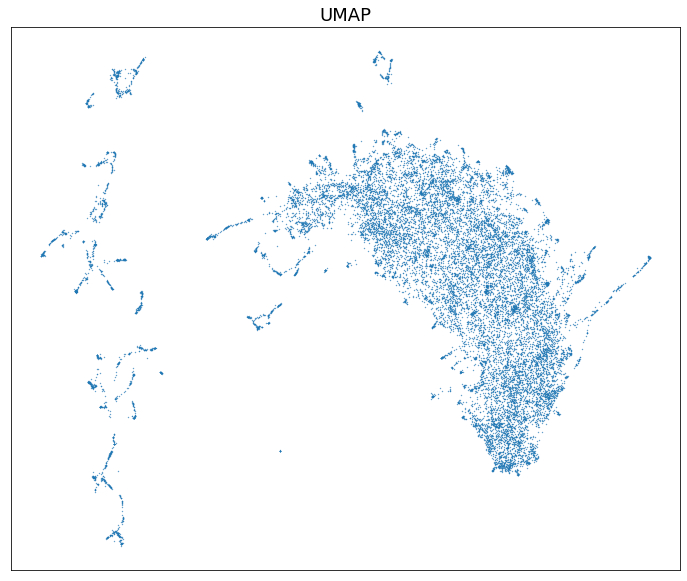

In [14]:
fig, ax = plt.subplots(figsize=(12, 10))
plt.scatter(embedding[:, 0], embedding[:, 1], cmap="Spectral", s=0.1)
plt.setp(ax, xticks=[], yticks=[])
plt.title("UMAP", fontsize=18)